# Fase 2 - Data Understanding

El UCLA Consortium for Neuropsychiatric Phenomics LA5c Study es un conjunto de datos cuyo **objetivo principal es descubrir las bases fisiológicas de las variaciones en los fenotipos de los sistemas psicológicos y neurales**, con la intención de avanzar en el desarrollo de tratamientos y en la comprensión de los trastornos neuropsiquiátricos.

El estudio incluyó a 272 participantes, de los cuales 265 fueron preprocesados. Estos se dividen en grupos de controles sanos y pacientes con diagnósticos de TDAH, trastorno bipolar y esquizofrenia. Se cuenta con metadatos de cada sujeto que contienen información pertinente para este proyecto: edad, género y diagnóstico.

El conjunto de datos incluye diversas modalidades de neuroimagen, como resonancia magnética estructural (MRI), imágenes con ponderación de difusión (DWI) y resonancia magnética funcional (fMRI), capturadas tanto en estado de reposo como durante la ejecución de cinco tareas cognitivas.

Los datos están organizados según el estándar Brain Imaging Data Structure (BIDS) y las imágenes se encuentran preprocesadas y estandarizadas para su uso en investigación. Esto implica que se ha realizado un proceso de normalización espacial, filtrado, corrección de ruido y movimiento de cabeza, estandarización a una plantilla de referencia y remoción de rasgos faciales para proteger la identidad.

Los datos a utilizar se encuentran en formato NIfTI (Neuroimaging Informatics Technology Initiative). En este formato, se almacenan de manera conjunta las matrices de las imágenes y los metadatos que describen las características de la imagen y los parámetros de adquisición.



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install numpy pandas matplotlib seaborn nibabel plotly


In [ ]:
import pandas
import numpy
import matplotlib
import seaborn
import nibabel
import os
import plotly

#dependendencias
python_version = !python --version
print(f"Python version: {python_version[0]}")



#versiones
print(f"Pandas version: {pandas.__version__}")
print(f"Numpy version: {numpy.__version__}")
print(f"Matplotlib version: {matplotlib.__version__}")
print(f"Seaborn version: {seaborn.__version__}")
print(f"Nibabel version: {nibabel.__version__}")
print(f"Plotly version: {plotly.__version__}")
print(f"OS version: {os.name}")

Python version: Python 3.12.12
Pandas version: 2.2.2
Numpy version: 2.0.2
Matplotlib version: 3.10.0
Seaborn version: 0.13.2
Nibabel version: 5.3.2
Plotly version: 5.24.1
OS version: posix


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nibabel as nib
import plotly
import os

#cycler

from cycler import cycler

def apply_purple_minimal_light():
    rc = {
        # --- Layout & tipografía
        "figure.figsize": (6.4, 4.0),
        "figure.dpi": 120,
        "savefig.dpi": 150,
        "figure.autolayout": True,

        "font.family": "DejaVu Sans",
        "font.size": 11,
        "axes.titlesize": 13,
        "axes.labelsize": 12,

        # --- Colores globales
        "figure.facecolor": "#FFFFFF",
        "axes.facecolor":   "#FFFFFF",
        "axes.edgecolor":   "#E5E7EB",
        "axes.labelcolor":  "#111827",
        "text.color":       "#111827",

        # --- Spines y ejes
        "axes.spines.top":  False,
        "axes.spines.right":False,
        "axes.spines.left": True,
        "axes.spines.bottom": True,
        "axes.linewidth":   0.8,

        # --- Grid minimal
        "axes.grid":        True,
        "grid.color":       "#E5E7EB",
        "grid.linestyle":   "-",
        "grid.linewidth":   0.6,
        "grid.alpha":       0.6,

        # --- Ticks
        "xtick.color":      "#374151",
        "ytick.color":      "#374151",
        "xtick.direction":  "out",
        "ytick.direction":  "out",
        "xtick.major.size": 3,
        "ytick.major.size": 3,
        "xtick.minor.size": 0,
        "ytick.minor.size": 0,

        # --- Líneas y marcadores
        "lines.linewidth":  2.0,
        "lines.markersize": 4,
        "lines.solid_capstyle": "round",

        # --- Leyenda
        "legend.frameon":   False,
        "legend.fontsize":  10,

        # --- Colormap por defecto
        "image.cmap":       "Purples",
    }

    # Paleta ciclo de colores (morados + neutros)
    palette = ["#6C5CE7", "#A78BFA", "#4C3BCF", "#C084FC", "#7C3AED", "#9333EA", "#6B7280", "#111827"]

    # Aplicar en Seaborn
    sns.set_theme(context="notebook", style="whitegrid", palette=palette, rc=rc)

    # Asegurar ciclo de color también en Matplotlib puro
    plt.rcParams.update(rc)
    plt.rcParams["axes.prop_cycle"] = cycler(color=palette)
apply_purple_minimal_light()

In [ ]:
# alojamiento del dataset
BASE_PATH = "/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva"

In [ ]:
def build_dataset(base_path,save=True,update=False):
    """
    Builds a DataFrame containing participant information and DWI file paths.

    Args:
        base_path (str): The base path to the dataset directory.

    Returns:
        pd.DataFrame: A DataFrame with 'participant_id', 'diagnosis', and 'path_dwi_file'
                      columns for participants with DWI data.
    """
    variables = ['participant_id', 'diagnosis', 'path_dwi_file','metadata_dwi']
    if not update:
        if os.path.exists(os.path.join(base_path, "dataset_diagnosis.pkl")):
            return pd.read_pickle(os.path.join(base_path, "dataset_diagnosis.pkl"))[variables]

    # Read the TSV file
    tsv_file = os.path.join(base_path, "participants.tsv")
    df_tsv_participants = pd.read_csv(tsv_file, sep="\t")

    # Filter the DataFrame to include only participants with DWI data
    df_with_dwi = df_tsv_participants[df_tsv_participants['dwi'] == 1.0].copy()

    # Construct the expected DWI file paths
    df_with_dwi['path_dwi_file'] = df_with_dwi['participant_id'].apply(
        lambda x: os.path.join(base_path, f"{x}/dwi/{x}_dwi.nii.gz")
    )

    # Metadata for dwi acquisition
    df_with_dwi['path_dwi_acq'] = df_with_dwi['participant_id'].apply(
        lambda x: os.path.join(base_path, f"{x}/dwi/{x}_dwi.json")
    )


    # Verify that the generated paths actually exist
    df_with_dwi = df_with_dwi[df_with_dwi['path_dwi_file'].apply(os.path.exists)].copy()
    df_with_dwi = df_with_dwi[df_with_dwi['path_dwi_acq'].apply(os.path.exists)].copy()
    # Upload metadata
    df_with_dwi['metadata_dwi'] = df_with_dwi['path_dwi_acq'].apply(lambda x: json.load(open(x)))

    # Select and return the required columns
    if save:
        df_with_dwi.to_pickle(os.path.join(base_path, "dataset_diagnosis.pkl"))

    return df_with_dwi[['participant_id', 'diagnosis', 'path_dwi_file','metadata_dwi']]

# Re-build the dataset using the improved function
dataset_diagnosis = build_dataset(BASE_PATH)
dataset_diagnosis.head()

,participant_id,diagnosis,path_dwi_file,metadata_dwi
0,sub-10159,CONTROL,/content/drive/MyDrive/root/UNAM/semestre9/min...,"{'ImageType': 'ORIGINAL/PRIMARY/M/ND/MOSAIC', ..."
1,sub-10171,CONTROL,/content/drive/MyDrive/root/UNAM/semestre9/min...,"{'ImageType': 'ORIGINAL/PRIMARY/M/ND/MOSAIC', ..."
2,sub-10189,CONTROL,/content/drive/MyDrive/root/UNAM/semestre9/min...,"{'ImageType': 'ORIGINAL/PRIMARY/M/ND/MOSAIC', ..."
3,sub-10193,CONTROL,/content/drive/MyDrive/root/UNAM/semestre9/min...,"{'ImageType': 'ORIGINAL/PRIMARY/M/ND/MOSAIC', ..."
4,sub-10206,CONTROL,/content/drive/MyDrive/root/UNAM/semestre9/min...,"{'ImageType': 'ORIGINAL/PRIMARY/M/ND/MOSAIC', ..."


## Metainformacion
En esta seccion vamos a trabajar con la metainformacion de las adquisiciones dwi

In [ ]:
df_metadata_dwin = pd.DataFrame(dataset_diagnosis['metadata_dwi'].tolist())
num_fields = df_metadata_dwin.shape[1]
print(f"Number of fields: {num_fields}")
df_metadata_dwin.head()

Number of fields: 34


,ImageType,ManufacturerModelName,ScanningSequence,SequenceVariant,ScanOptions,MRAcquisitionType,SequenceName,RepetitionTime,EchoTime,NumberOfAverages,...,TransmitCoilName,AcquisitionMatrix,InPlanePhaseEncodingDirection,FlipAngle,VariableFlipAngleFlag,PatientPosition,EffectiveEchoSpacing,TotalReadoutTime,SliceTiming,PhaseEncodingDirection
0,ORIGINAL/PRIMARY/M/ND/MOSAIC,TrioTim,EP,SK/SP,PFP/FS,2D,*ep_b1000#10,7.0,0.0926,1,...,Body,96/0/0/96,COL,90,N,HFS,0.00069,0.088318,"[3.515, 0, 3.655, 0.1425, 3.795, 0.2825, 3.937...",j-
1,ORIGINAL/PRIMARY/M/ND/MOSAIC,TrioTim,EP,SK/SP,PFP/FS,2D,*ep_b1000#10,7.0,0.0926,1,...,Body,96/0/0/96,COL,90,N,HFS,0.00069,0.088318,"[3.5125, 0, 3.6525, 0.14, 3.795, 0.28, 3.935, ...",j-
2,ORIGINAL/PRIMARY/M/ND/MOSAIC,TrioTim,EP,SK/SP,PFP/FS,2D,*ep_b1000#10,7.0,0.0926,1,...,Body,96/0/0/96,COL,90,N,HFS,0.00069,0.088318,"[3.5125, 0, 3.655, 0.14, 3.795, 0.28, 3.935, 0...",j-
3,ORIGINAL/PRIMARY/M/ND/MOSAIC,TrioTim,EP,SK/SP,PFP/FS,2D,*ep_b1000#10,7.0,0.0926,1,...,Body,96/0/0/96,COL,90,N,HFS,0.00069,0.088318,"[3.5125, 0, 3.6525, 0.14, 3.795, 0.28, 3.935, ...",j-
4,ORIGINAL/PRIMARY/M/ND/MOSAIC,TrioTim,EP,SK/SP,PFP/FS,2D,*ep_b1000#10,7.0,0.0926,1,...,Body,96/0/0/96,COL,90,N,HFS,0.00069,0.088318,"[3.5125, 0, 3.655, 0.14, 3.795, 0.28, 3.935, 0...",j-


## Diccionario de Datos sobre los metadatos

| **Campo** | **Definición conceptual** | **Tipo / Unidades** | **Valores únicos** | **Interpretación** |
|---|---|---|---|---|
| ImageType | Conjunto de etiquetas que describe cómo se generó la imagen y si es cruda o procesada. | Cadena | 'ORIGINAL/PRIMARY/M/ND/MOSAIC', 'ORIGINAL/PRIMARY/DIFFUSION/NONE/ND/MOSAIC' | `ORIGINAL/PRIMARY` indica imagen base; `DIFFUSION` señala contraste de difusión; `M/ND/NONE` son banderas internas; `MOSAIC` es el empaquetado Siemens de múltiples cortes en un solo cuadro. |
| ManufacturerModelName | Modelo comercial del escáner. | Cadena | 'TrioTim' | Equipo Siemens MAGNETOM Trio con tecnología Tim; constante en el dataset. |
| ScanningSequence | Clase general de secuencia usada. | Cadena | 'EP' | EPI (Echo-Planar Imaging), típica para DWI por su rapidez y sensibilidad a susceptibilidad. |
| SequenceVariant | Variante/flags específicos de la secuencia definidos por el fabricante. | Cadena | 'SK/SP' | Convención Siemens; suele referir a segmentación de k-espacio y “spoiling”. |
| ScanOptions | Opciones adicionales activadas durante la adquisición. | Cadena | 'PFP/FS' | Incluye compensación/ajuste previo y supresión de grasa; ayuda a reducir artefactos de grasa. |
| MRAcquisitionType | Geometría de adquisición del volumen. | Cadena | '2D' | Adquisición por cortes; relevante para orden/tiempos de corte y correcciones. |
| SequenceName | Nombre interno de la secuencia. | Cadena | '*ep_b1000#10', 'ep_b1000#62', '*ep_b1000#62', '*ep_b1000#2' | `ep` denota EPI; `b1000` sugiere b≈1000 s/mm²; el sufijo `#n` es un índice interno (eco/bucle). |
| RepetitionTime | Tiempo entre excitaciones consecutivas (TR). | Numérico; s | 7.0, 8.4, 9.0 | TR más largo suele mejorar recuperación T1 y SNR; aquí varía entre series. |
| EchoTime | Tiempo entre la excitación y la lectura del eco (TE). | Numérico; s | 0.0926, 0.093 | TE ≈93 ms, típico para DWI EPI; diferencias mínimas entre series. |
| NumberOfAverages | Repeticiones promediadas (NEX). | Entero | 1 | Una sola media; tiempo más corto con SNR moderado. |
| ImagingFrequency | Frecuencia central de RF usada por el sistema. | Numérico; Hz (a veces reportado en MHz) | {muchos valores}; ejs: "123249931", "123249590", "123249888" | Alta cardinalidad; pequeñas variaciones son normales por ajuste/deriva del campo a 3T (~123 MHz). |
| MagneticFieldStrength | Intensidad del imán principal. | Numérico; T | 3 | Escáner de 3T; mayor SNR y susceptibilidad que 1.5T. |
| NumberOfPhaseEncodingSteps | Pasos de codificación en la dirección de fase. | Entero | 72 | Define resolución y FOV en fase; coherente con la matriz declarada. |
| EchoTrainLength | Número de ecos por TR (según vendor). | Entero | 1 | En Siemens para EPI puede no reflejar el “train” clásico; aquí queda como bandera. |
| PercentSampling | Porcentaje muestreado en frecuencia. | Entero; % | 100 | Muestreo completo del k-espacio en frecuencia. |
| PercentPhaseFieldOfView | Porcentaje del FOV en la dirección de fase. | Entero; % | 100 | FOV completo en fase; reduce aliasing por recorte. |
| PixelBandwidth | Ancho de banda por píxel. | Entero; Hz/píxel | 2265, 2264 | BW alta ayuda a reducir distorsión EPI con leve impacto en SNR; dos valores casi idénticos. |
| EPIFactor | Líneas de k-espacio por excitación en EPI. | Entero | 128 | Factor moderado; acelera lectura pero aumenta sensibilidad a distorsión. |
| AccelerationFactorPE | Aceleración paralela en fase (p. ej., GRAPPA/SENSE). | Entero | 1 | Sin aceleración paralela; más distorsión que con factores >1 pero SNR más estable. |
| TotalScanTimeSec | Duración total de la serie. | Entero; s | 464, 556, 596 | Diferencias atribuibles a #cortes/direcciones/tiempos de espera; útil para control por serie. |
| ReceiveCoilName | Bobina receptora utilizada. | Cadena | 'HeadMatrix' | Bobina de cabeza Siemens (Tim); adecuada para DWI cerebral. |
| DeviceSerialNumber | Número de serie del equipo. | Cadena | '35343', '35426' | Dos unidades diferentes; considerar como posible efecto de lote/hardware. |
| SoftwareVersions | Versión del software del escáner. | Cadena | 'syngo MR B15', 'syngo MR B17' | Mezcla de versiones; posibles diferencias en reconstrucción y metadatos. |
| ProtocolName | Nombre del protocolo clínico/de investigación. | Cadena | 'DTI 64dir' | Protocolo de difusión con 64 direcciones. |
| TransmitCoilName | Bobina transmisora. | Cadena | 'Body' | Transmisión con bobina de cuerpo; estándar en cabeza. |
| AcquisitionMatrix | Matriz de adquisición (convención Siemens). | Cadena | '96/0/0/96' | 96 (frecuencia) × 96 (fase); concuerda con FOV/muestreo al 100%. |
| InPlanePhaseEncodingDirection | Dirección de fase en el plano imagen. | Cadena | 'COL' | La codificación de fase corre a lo largo de columnas. |
| FlipAngle | Ángulo de excitación del pulso RF. | Entero; ° | 90 | Excitación típica de 90° para SE-EPI de difusión. |
| VariableFlipAngleFlag | Indica si el ángulo de flip varía. | Cadena | 'N' | Ángulo fijo en toda la serie. |
| PatientPosition | Orientación del paciente en la mesa. | Cadena | 'HFS' | Head First Supine: cabeza primero, decúbito supino. |
| EffectiveEchoSpacing | Separación efectiva entre ecos en EPI. | Numérico; s | 0.00068998 | ≈0.69 ms; clave para distorsión y correcciones (p. ej., topup). |
| TotalReadoutTime | Tiempo total de lectura EPI en la dirección de fase. | Numérico; s | 0.08831782 | ≈88 ms; a mayor tiempo, mayor distorsión por susceptibilidad. |
| PhaseEncodingDirection | Dirección de fase en convención NIfTI con signo. | Cadena | 'j-' | Fase a lo largo de j invertido; deforma a lo largo de −j y guía correcciones. |


In [ ]:
print("Null values per Variables in Metadata")
pd.DataFrame(df_metadata_dwin.isna().sum().values.reshape(1, -1), columns=df_metadata_dwin.columns)

Null values per Variables in Metadata


,ImageType,ManufacturerModelName,ScanningSequence,SequenceVariant,ScanOptions,MRAcquisitionType,SequenceName,RepetitionTime,EchoTime,NumberOfAverages,...,TransmitCoilName,AcquisitionMatrix,InPlanePhaseEncodingDirection,FlipAngle,VariableFlipAngleFlag,PatientPosition,EffectiveEchoSpacing,TotalReadoutTime,SliceTiming,PhaseEncodingDirection
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Como podemos ver, en este conjunto de datos de los metadatos no hoy valores faltantes

---



## Variable Objetivo - Diagnostico







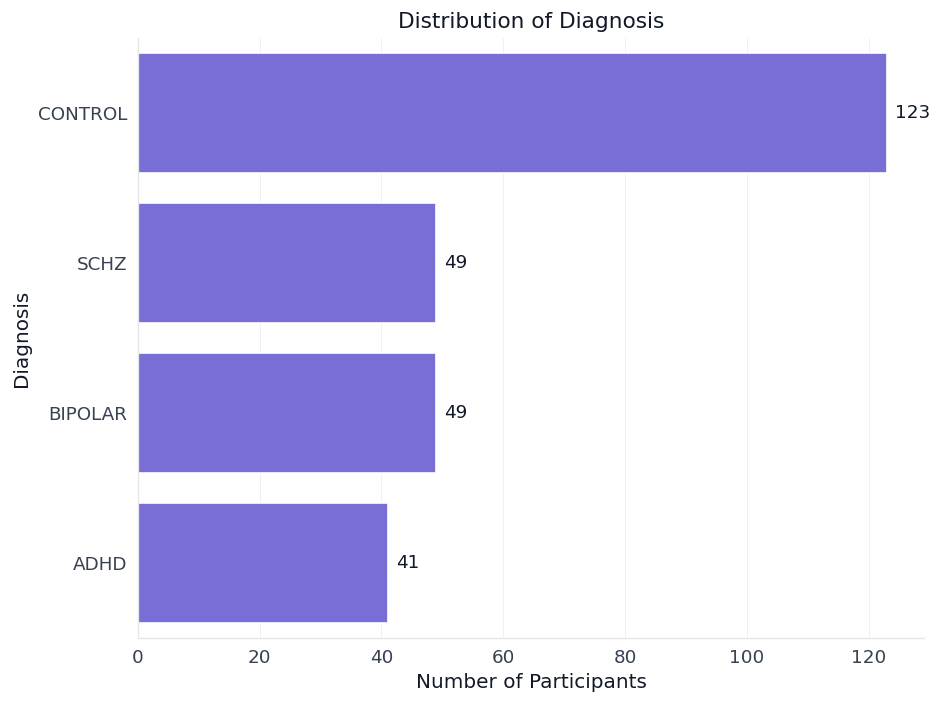

In [ ]:
plt.figure(figsize=(8, 6))
ax = sns.countplot(data=dataset_diagnosis, y='diagnosis')
plt.title('Distribution of Diagnosis')
plt.xlabel('Number of Participants')
plt.ylabel('Diagnosis')

# Add exact counts to the bars
for p in ax.patches:
    ax.annotate(f'{int(p.get_width())}', (p.get_width(), p.get_y() + p.get_height() / 2.),
                ha='left', va='center', xytext=(5, 0), textcoords='offset points')

plt.show()

De la anterior visualizacion, hay un desbalance entre las pacientes que son grupo de control, asi como los diferentes diagnosticos. Esto puede que afecte la forma en que particionaremos los conjuntos de entrenamiento

In [ ]:
from __future__ import annotations
from dataclasses import dataclass
from pathlib import Path
from typing import Optional, Sequence, Literal, Tuple, Union
import numpy as np

# =========================
# CARGA DWI
# =========================
try:
    import nibabel as nib
except ImportError as e:
    raise ImportError("Este módulo requiere 'nibabel'. Instálalo con: pip install nibabel") from e


@dataclass
class DwiData:
    path: Path
    img: nib.Nifti1Image
    data: Union[np.ndarray, object]  # ndarray o ArrayProxy (perezoso)
    affine: np.ndarray
    header: nib.nifti1.Nifti1Header
    shape: Tuple[int, ...]
    zooms: Tuple[float, ...]
    is_4d: bool
    n_volumes: int
    bvals: Optional[np.ndarray]
    bvecs: Optional[np.ndarray]

    #representacion cadena
    def __str__(self):
        return f"DwiData(path={self.path}, shape={self.data.shape}"


def _basename_without_niigz(p: Path) -> str:
    name = p.name
    if name.endswith(".nii.gz"):
        return name[:-7]
    if name.endswith(".nii"):
        return name[:-4]
    return p.stem


def guess_bval_bvec_paths(dwi_path: Path) -> Tuple[Path, Path]:
    base = _basename_without_niigz(dwi_path)
    bval = dwi_path.with_name(base + ".bval")
    bvec = dwi_path.with_name(base + ".bvec")
    return bval, bvec


def _load_bvals_bvecs(bval_path: Path, bvec_path: Path) -> Tuple[Optional[np.ndarray], Optional[np.ndarray]]:
    bvals = None
    bvecs = None
    if bval_path.exists():
        bvals = np.loadtxt(bval_path, dtype=float)
    if bvec_path.exists():
        arr = np.loadtxt(bvec_path, dtype=float)
        if arr.ndim == 1:
            arr = arr.reshape(-1, 3) if arr.size % 3 == 0 else arr[:, None]
        if arr.ndim == 2:
            if arr.shape[0] == 3 and arr.shape[1] != 3:
                bvecs = arr.T
            elif arr.shape[1] == 3:
                bvecs = arr
            else:
                bvecs = arr
        else:
            bvecs = arr
    return bvals, bvecs


def load_dwi(
    path: Union[str, Path],
    *,
    mode: Literal["proxy", "float32", "native"] = "proxy",
    indices: Optional[Sequence[int]] = None,
    mmap: bool = True,
    apply_scaling: bool = True,
    dtype: Optional[np.dtype] = np.float32,
    load_gradients: bool = True,
) -> DwiData:
    """
    Carga óptima de una DWI (3D/4D). Devuelve DwiData.
    """
    path = Path(path)
    if not path.exists():
        raise FileNotFoundError(f"No se encontró el archivo DWI: {path}")

    img = nib.load(str(path), mmap=mmap)
    hdr = img.header
    shape = tuple(int(x) for x in img.shape)
    affine = img.affine
    zooms = tuple(float(z) for z in hdr.get_zooms()[: len(shape)])
    is_4d = (len(shape) == 4)
    n_volumes = int(shape[3]) if is_4d else 1

    if mode == "proxy":
        data = img.slicer[..., list(indices)] if (is_4d and indices is not None) else img.dataobj
    else:
        if is_4d and indices is not None:
            slicer = (slice(None), slice(None), slice(None), list(indices))
            sub = img.dataobj[slicer] if apply_scaling else np.asanyarray(img.dataobj[slicer])
        else:
            sub = img.get_fdata(dtype=np.float32 if mode == "float32" else None, caching="unchanged") if apply_scaling else np.asanyarray(img.dataobj)
        if mode == "float32":
            data = sub.astype(np.float32 if dtype is None else dtype, copy=False)
        elif mode == "native":
            data = sub
        else:
            raise ValueError(f"mode desconocido: {mode}")

    bvals = bvecs = None
    if load_gradients:
        bval_p, bvec_p = guess_bval_bvec_paths(path)
        bvals, bvecs = _load_bvals_bvecs(bval_p, bvec_p)
        if is_4d and indices is not None and bvals is not None and len(bvals) == n_volumes:
            idx = np.array(list(indices), dtype=int)
            bvals = bvals[idx]
            if bvecs is not None and bvecs.shape[0] == n_volumes:
                bvecs = bvecs[idx, :]

    return DwiData(
        path=path, img=img, data=data, affine=affine, header=hdr,
        shape=shape, zooms=zooms, is_4d=is_4d, n_volumes=n_volumes,
        bvals=bvals, bvecs=bvecs,
    )


# =========================
# HELPERS DE VISUALIZACIÓN
# =========================
def _finite_percentile_window(vol: np.ndarray, prc=(2.0, 98.0)) -> tuple[float, float]:
    m = np.isfinite(vol)
    if not m.any():
        return 0.0, 1.0
    vmin = np.percentile(vol[m], prc[0])
    vmax = np.percentile(vol[m], prc[1])
    if not np.isfinite(vmin): vmin = float(np.nanmin(vol))
    if not np.isfinite(vmax): vmax = float(np.nanmax(vol))
    if vmax <= vmin: vmax = vmin + 1e-6
    return float(vmin), float(vmax)


def _auto_bbox(vol: np.ndarray, thr: float|None=None, margin: int=2) -> tuple[slice,slice,slice]:
    v = np.nan_to_num(vol, nan=0.0, posinf=0.0, neginf=0.0)
    nz = v[v>0]
    if thr is None:
        thr = float(np.percentile(nz, 10)) if nz.size else 0.0
    mask = v > thr
    if not mask.any():
        X,Y,Z = vol.shape
        return slice(0,X), slice(0,Y), slice(0,Z)
    xs = np.where(mask.any(axis=(1,2)))[0]
    ys = np.where(mask.any(axis=(0,2)))[0]
    zs = np.where(mask.any(axis=(0,1)))[0]
    x0,x1 = max(xs[0]-margin,0), min(xs[-1]+1+margin, vol.shape[0])
    y0,y1 = max(ys[0]-margin,0), min(ys[-1]+1+margin, vol.shape[1])
    z0,z1 = max(zs[0]-margin,0), min(zs[-1]+1+margin, vol.shape[2])
    return slice(x0,x1), slice(y0,y1), slice(z0,z1)


def _strides_for_target_voxels(shape_xyz: tuple[int,int,int], zooms_xyz: tuple[float,float,float],
                               max_voxels: int=1_200_000) -> tuple[int,int,int]:
    X,Y,Z = shape_xyz
    cur = X*Y*Z
    if cur <= max_voxels:
        return (1,1,1)
    scale = (cur / max_voxels) ** (1/3)
    dx,dy,dz = zooms_xyz
    inv = np.array([1/max(dx,1e-6), 1/max(dy,1e-6), 1/max(dz,1e-6)], dtype=float)
    inv = inv / (inv.mean() + 1e-12)
    raw = np.ceil(scale * inv).astype(int)
    sx,sy,sz = np.maximum(raw, 1)
    def voxels(s):
        return int(np.ceil(X/s[0]))*int(np.ceil(Y/s[1]))*int(np.ceil(Z/s[2]))
    while voxels((sx,sy,sz)) > max_voxels:
        i = int(np.argmax([X/sx, Y/sy, Z/sz]))
        if i==0: sx += 1
        elif i==1: sy += 1
        else: sz += 1
    return int(sx), int(sy), int(sz)


def _apply_stride_and_crop(vol: np.ndarray, zooms: Tuple[float,float,float],
                           max_voxels: int, crop: bool,
                           min_stride: Tuple[int,int,int]=(1,1,1)) -> tuple[np.ndarray, tuple[slice,slice,slice], tuple[int,int,int]]:
    if crop:
        sX,sY,sZ = _auto_bbox(vol)
        vol = vol[sX, sY, sZ]
    else:
        sX,sY,sZ = slice(0,vol.shape[0]), slice(0,vol.shape[1]), slice(0,vol.shape[2])
    sx,sy,sz = _strides_for_target_voxels(vol.shape[:3], zooms, max_voxels=max_voxels)
    sx,sy,sz = max(sx, min_stride[0]), max(sy, min_stride[1]), max(sz, min_stride[2])
    vol_ds = vol[::sx, ::sy, ::sz]
    return vol_ds, (sX,sY,sZ), (sx,sy,sz)


def _gaussian_if_needed(vol: np.ndarray, sigma: Optional[float]) -> np.ndarray:
    if sigma is None or sigma <= 0:
        return vol
    try:
        from scipy.ndimage import gaussian_filter
        return gaussian_filter(vol, sigma=float(sigma), mode="nearest")
    except Exception:
        return vol


def _largest_component_mask(vol: np.ndarray, thr: float, min_frac: float=0.001) -> Optional[np.ndarray]:
    try:
        from scipy import ndimage as ndi
    except Exception:
        return None
    m = vol > thr
    if not m.any():
        return None
    lbl, n = ndi.label(m)
    if n <= 1:
        return m
    sizes = ndi.sum(m, lbl, index=np.arange(1, n+1))
    biggest = int(np.argmax(sizes) + 1)
    keep = (lbl == biggest)
    total = m.size
    small = np.isin(lbl, np.where(sizes < total*min_frac)[0] + 1)
    keep[small] = False
    return keep


# =========================
# VISUALIZACIÓN
# =========================
def visualize_dwi(
    x,
    *,
    volume: Union[Literal["auto", "b0", "mean_bgt0"], int]="auto",
    mode: Literal["mosaic","orthogonal","interactive","3d"]="mosaic",
    engine: Literal["auto","volume","isosurface"]="auto",
    n_slices=16,
    percentile=(2.0, 98.0),
    normalize=False,
    figsize=(10, 8),
    cmap="gray",
    title=None,
    show=True,
    # Calidad/velocidad
    max_voxels_3d=2_500_000,
    crop_content=True,
    min_stride=(1,1,1),
    gauss_sigma: Optional[float]=0.8,
    iso_percentile=65.0,
    multi_iso: Optional[Sequence[float]]=None,  # ej (55,70)
    clean_components=True,
    prefer_b0_for_3d=True,
):
    """
    Visualiza DWI en 2D/3D con optimizaciones.
    """
    import matplotlib.pyplot as plt
    from pathlib import Path

    # ---- normalizar entrada (data, bvals, zooms) ----
    bvals = None
    zooms = (1.0, 1.0, 1.0)

    if isinstance(x, (str, Path)):
        dwi = load_dwi(x, mode="proxy", load_gradients=True)
        data = np.asanyarray(dwi.data)
        bvals = dwi.bvals
        if len(dwi.zooms) >= 3:
            zooms = dwi.zooms[:3]
    else:
        try:
            data = np.asanyarray(x.data)
            bvals = getattr(x, "bvals", None)
            if hasattr(x, "zooms") and x.zooms and len(x.zooms) >= 3:
                zooms = x.zooms[:3]
        except Exception:
            data = np.asarray(x)

    # ---- elegir volumen 3D ----
    def choose_volume(data, volume, bvals):
        if data.ndim == 3:
            return data, -1, "3D"
        if data.ndim != 4:
            raise ValueError(f"Se espera 3D o 4D, recibido: {data.shape}")
        n = data.shape[3]
        if isinstance(volume, int):
            if not (0 <= volume < n):
                raise IndexError(f"Índice fuera de rango: 0..{n-1}")
            return data[..., volume], volume, f"idx={volume}"
        if volume == "auto":
            if prefer_b0_for_3d and bvals is not None and np.isfinite(bvals).any():
                idxs = np.where(bvals <= 50)[0]
                if idxs.size:
                    i = int(idxs[0]); return data[..., i], i, "b0"
            return np.mean(data, axis=3), -1, "mean_all"
        if volume == "b0":
            if bvals is None: raise ValueError("volume='b0' requiere bvals.")
            idxs = np.where(bvals <= 50)[0]
            if idxs.size == 0: raise ValueError("No hay b≈0.")
            i = int(idxs[0]); return data[..., i], i, "b0"
        if volume == "mean_bgt0":
            if bvals is None: raise ValueError("volume='mean_bgt0' requiere bvals.")
            idxs = np.where(bvals > 50)[0]
            if idxs.size == 0: raise ValueError("No hay b>0.")
            return np.mean(data[..., idxs], axis=3), -1, "mean_bgt0"
        raise ValueError(f"Estrategia desconocida: {volume}")

    vol3d, idx_info, strategy = choose_volume(data, volume, bvals)

    # ---- saneo intensidades / normalización ----
    vol = np.nan_to_num(
        vol3d, nan=0.0,
        posinf=(np.nanmax(vol3d) if np.isfinite(vol3d).any() else 0.0),
        neginf=0.0
    ).astype(np.float32, copy=False)
    if normalize:
        m, M = float(np.min(vol)), float(np.max(vol))
        if M > m: vol = (vol - m) / (M - m)

    vmin, vmax = _finite_percentile_window(vol, percentile)

    # ---- 2D ----
    if mode == "orthogonal":
        import matplotlib.pyplot as plt
        cx, cy, cz = (s // 2 for s in vol.shape)
        fig = plt.figure(figsize=figsize)

        ax1 = fig.add_subplot(1, 3, 1)
        ax1.imshow(vol[:, :, cz].T, origin="lower", cmap=cmap, vmin=vmin, vmax=vmax)
        ax1.set_title("Axial"); ax1.axis("off")

        ax2 = fig.add_subplot(1, 3, 2)
        ax2.imshow(np.flipud(vol[:, cy, :].T), cmap=cmap, vmin=vmin, vmax=vmax)
        ax2.set_title("Coronal"); ax2.axis("off")

        ax3 = fig.add_subplot(1, 3, 3)
        ax3.imshow(np.flipud(vol[cx, :, :].T), cmap=cmap, vmin=vmin, vmax=vmax)
        ax3.set_title("Sagital"); ax3.axis("off")

        fig.suptitle(title or f"DWI — {strategy}", y=0.98)
        fig.tight_layout()
        if show: plt.show()
        return fig

    if mode == "mosaic":
        import matplotlib.pyplot as plt
        zdim = vol.shape[2]
        n = max(1, int(n_slices))
        idxs = np.linspace(0, zdim - 1, n, dtype=int)
        ncols = int(np.ceil(np.sqrt(n)))
        nrows = int(np.ceil(n / ncols))
        fig, axes = plt.subplots(nrows, ncols, figsize=figsize)
        axes = np.atleast_1d(axes).ravel()
        for ax, zi in zip(axes, idxs):
            ax.imshow(vol[:, :, zi].T, origin="lower", cmap=cmap, vmin=vmin, vmax=vmax)
            ax.set_title(f"z={zi}"); ax.axis("off")
        for ax in axes[len(idxs):]:
            ax.axis("off")
        fig.suptitle(title or f"DWI — {strategy} | {n} cortes", y=0.98)
        fig.tight_layout()
        if show: plt.show()
        return fig

    # ---- 3D ----
    if mode in {"3d", "interactive"}:
        try:
            import plotly.graph_objects as go
        except ImportError:
            raise ImportError("El modo 3D requiere plotly (pip install plotly)")

        vol_pre = _gaussian_if_needed(vol, sigma=gauss_sigma)

        vol_ds, (sX,sY,sZ), (sx,sy,sz) = _apply_stride_and_crop(
            vol_pre, zooms=zooms, max_voxels=max_voxels_3d, crop=crop_content, min_stride=min_stride
        )

        dx,dy,dz = zooms
        dx_eff, dy_eff, dz_eff = dx*sx, dy*sy, dz*sz

        if engine == "auto":
            engine = "isosurface" if vol_ds.size > 1_000_000 else "volume"

        vmin_ds, vmax_ds = _finite_percentile_window(vol_ds, percentile)
        base_iso = float(vmin_ds + (vmax_ds - vmin_ds) * (iso_percentile/100.0))
        if not np.isfinite(base_iso):
            base_iso = float(np.nanmean(vol_ds))

        mask_clean = None
        if engine == "isosurface" and clean_components:
            thr0 = float(vmin_ds + 0.5*(vmax_ds - vmin_ds))
            mask_clean = _largest_component_mask(vol_ds, thr=thr0, min_frac=0.0008)
            if mask_clean is not None:
                vol_ds = vol_ds * mask_clean.astype(vol_ds.dtype)

        isos = [base_iso]
        if multi_iso is not None and len(multi_iso) >= 2:
            isos = [float(vmin_ds + (vmax_ds - vmin_ds)*(p/100.0)) for p in multi_iso]

        if engine == "isosurface":
            try:
                from skimage.measure import marching_cubes
            except ImportError:
                engine = "volume"

        if engine == "isosurface":
            meshes = []
            for lvl in isos:
                # marcha en (z,y,x) y luego convertimos a físico
                verts, faces, _, _ = marching_cubes(vol_ds.transpose(2,1,0), level=lvl, step_size=1)
                vx = verts[:,2]*dx_eff; vy = verts[:,1]*dy_eff; vz = verts[:,0]*dz_eff
                i,j,k = faces.T
                meshes.append(go.Mesh3d(
                    x=vx, y=vy, z=vz, i=i, j=j, k=k,
                    opacity=0.82, flatshading=False,
                    lighting=dict(ambient=0.3, diffuse=0.7, specular=0.35, roughness=0.9)
                ))
            fig = go.Figure(data=meshes)
        else:
            V = vol_ds.transpose(2,1,0).ravel(order="C")
            nz, ny, nx = vol_ds.shape[2], vol_ds.shape[1], vol_ds.shape[0]
            z = np.arange(nz, dtype=np.float32) * dz_eff
            y = np.arange(ny, dtype=np.float32) * dy_eff
            x = np.arange(nx, dtype=np.float32) * dx_eff
            Z = np.repeat(z, ny*nx); Y = np.tile(np.repeat(y, nx), nz); X = np.tile(x, ny*nz)
            fig = go.Figure(data=go.Volume(
                x=X, y=Y, z=Z, value=V,
                isomin=float(vmin_ds), isomax=float(vmax_ds),
                surface_count=16, opacity=0.22,
                caps=dict(x_show=False,y_show=False,z_show=False),
                colorscale="Purples", showscale=False
            ))

        fig.update_layout(
            width=int(figsize[0]*96), height=int(figsize[1]*96),
            title=title or f"DWI 3D — {strategy}  |  crop:{crop_content} stride:{(sx,sy,sz)}",
            margin=dict(l=0,r=0,t=40,b=0),
            scene=dict(
                xaxis_title="i · dx", yaxis_title="j · dy", zaxis_title="k · dz",
                aspectmode="data"
            ),
        )
        return fig

    raise ValueError(f"Modo desconocido: {mode}")


In [ ]:
dwi_path = "/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10159/dwi/sub-10159_dwi.nii.gz"
visualize_dwi(
    dwi_path, mode="3d", engine="volume",
    volume=0,
    percentile=(0.5,99.5), max_voxels_3d=2_500_000,
    min_stride=(1,1,1), gauss_sigma=0.3,
    title="Volumétrico"
)


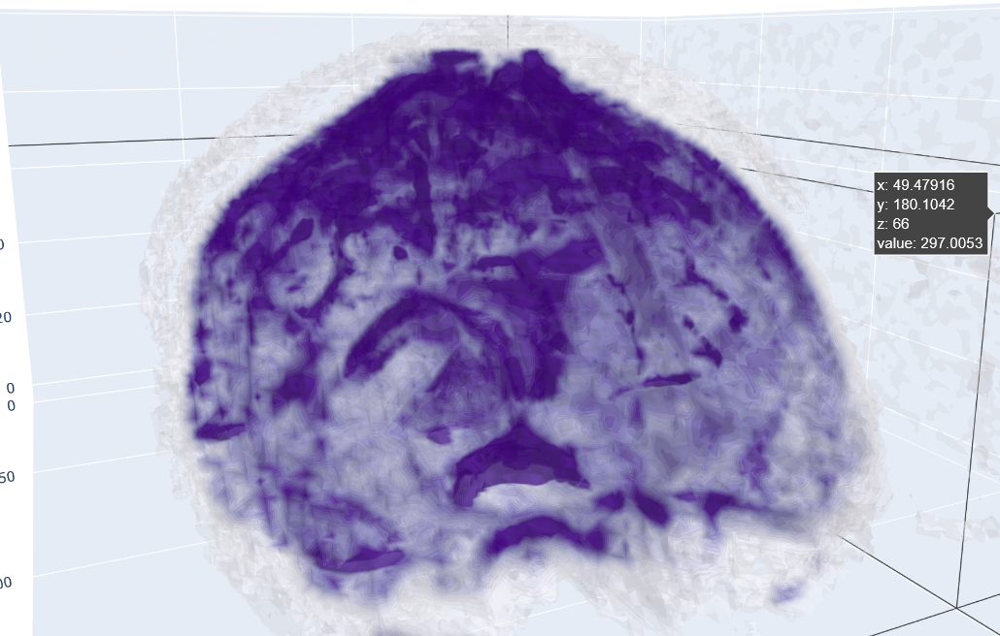

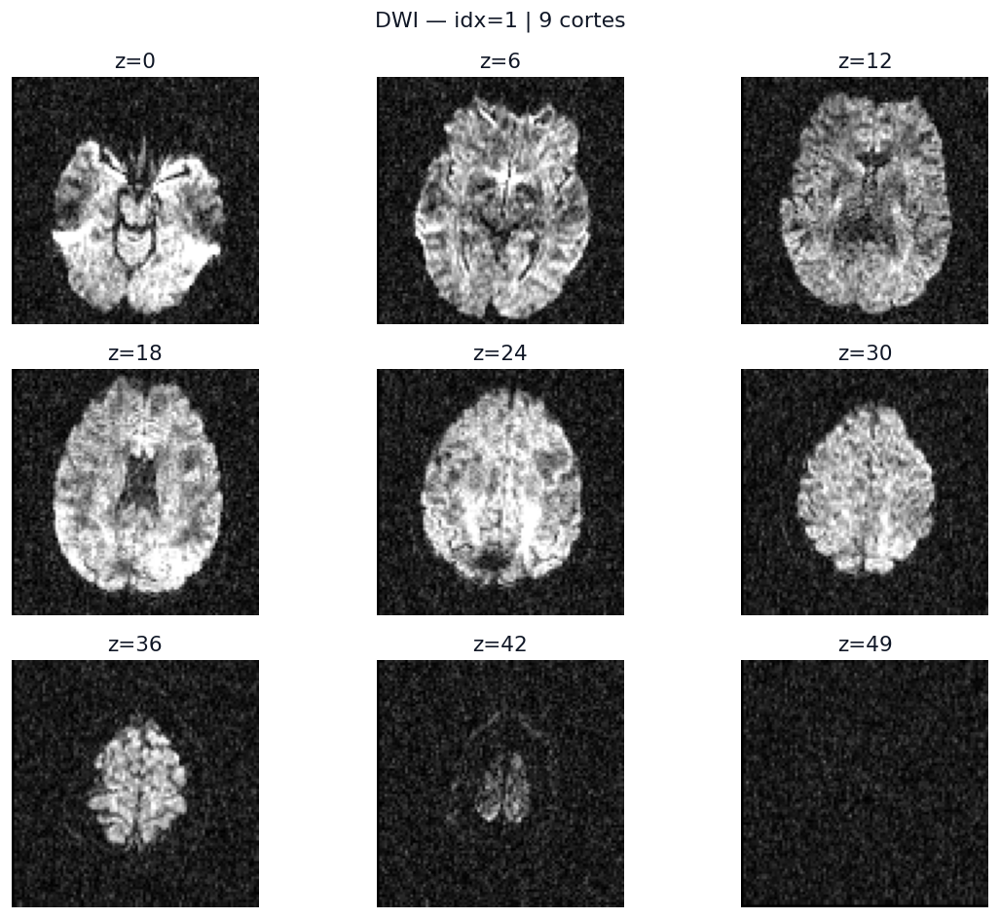

In [ ]:
fig = visualize_dwi(dwi_path,mode="mosaic",volume=1,n_slices=9)
plt.show()

(<Figure size 1920x480 with 4 Axes>,
 array([<Axes: title={'center': 'idx 5 | b=1000'}>,
        <Axes: title={'center': 'idx 20 | b=1000'}>,
        <Axes: title={'center': 'idx 40 | b=1000'}>,
        <Axes: title={'center': 'idx 50 | b=1000'}>], dtype=object))

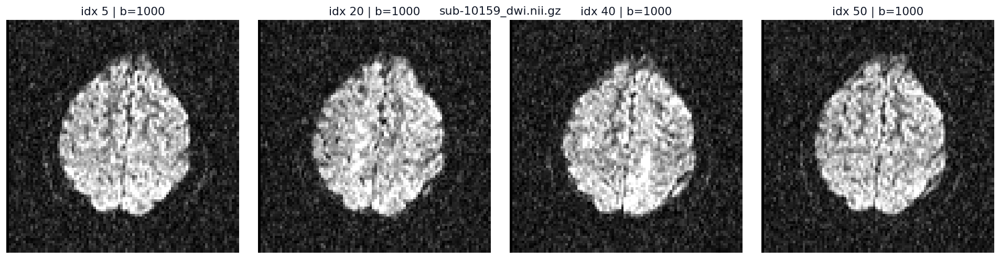

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
dwi_path = "/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10159/dwi/sub-10159_dwi.nii.gz"

# ---------- OPCIONAL: cargar a numpy (si quieres leer NIfTI) ----------
def load_dwi_to_numpy(dwi_path: str | Path, dtype=np.float32, apply_scaling: bool=True) -> np.ndarray:
    """
    Carga un NIfTI DWI a un arreglo numpy 4D (X, Y, Z, N).
    Requiere nibabel si usas este helper, pero la visualización es independiente.
    """
    import nibabel as nib
    img = nib.load(str(dwi_path))
    if apply_scaling:
        data = img.get_fdata(dtype=dtype, caching="unchanged")
    else:
        data = np.asarray(img.dataobj).astype(dtype, copy=False)
    if data.ndim != 4:
        raise ValueError(f"Se esperaba 4D (X,Y,Z,N). Forma leída: {data.shape}")
    return data

# ---------- OPCIONAL: leer bvals (para títulos) ----------
def load_bvals_from_path(dwi_path: str | Path) -> np.ndarray | None:
    p = Path(dwi_path)
    name = p.name
    if name.endswith(".nii.gz"):
        base = name[:-7]
    elif name.endswith(".nii"):
        base = name[:-4]
    else:
        base = p.stem
    bval_path = p.with_name(base + ".bval")
    if bval_path.exists():
        try:
            return np.loadtxt(bval_path, dtype=float)
        except Exception:
            return None
    return None

# ---------- VISUALIZACIÓN PURA CON NUMPY ----------
def visualice_dwi_channels_numpy(
    z_level: int,
    data4d: np.ndarray,
    idx_channels,
    *,
    bvals: np.ndarray | None = None,
    shared_contrast: bool = True,
    percentiles: tuple[float, float] = (2.0, 98.0),
    cmap: str = "gray",
    transpose: bool = True,     # True -> im.T + origin='lower' (estética típica MRI)
    title: str | None = None,
):
    """
    Visualiza el mismo corte axial z en varios canales de un volumen DWI 4D.

    Parámetros
    ----------
    z_level : int
        Índice axial (0..Z-1). Soporta negativos (p.ej. -1 = último).
    data4d : np.ndarray
        Arreglo 4D con forma (X, Y, Z, N).
    idx_channels : secuencia de int
        Volúmenes a mostrar del 4º eje.
    bvals : np.ndarray | None
        Array de b-values (N,), para etiquetar títulos. Opcional.
    shared_contrast : bool
        Si True, usa una ventana [vmin,vmax] compartida (percentiles globales).
        Si False, cada canal calcula su propio vmin/vmax.
    percentiles : (low, high)
        Percentiles para ventana robusta de intensidades.
    transpose : bool
        Si True, muestra im.T con origin='lower'.
    title : str | None
        Título de la figura.

    Retorna
    -------
    (fig, axes)
    """
    # --- Validaciones de forma ---
    if not isinstance(data4d, np.ndarray) or data4d.ndim != 4:
        raise ValueError(f"`data4d` debe ser np.ndarray 4D (X,Y,Z,N). Recibido: {type(data4d)}, shape={getattr(data4d, 'shape', None)}")
    X, Y, Z, N = data4d.shape

    # Normaliza z_level
    z = z_level if z_level >= 0 else Z + z_level
    if not (0 <= z < Z):
        raise IndexError(f"z_level fuera de rango: 0..{Z-1} (z={z_level}, Z={Z})")

    # Normaliza y valida idx_channels
    idx_list = list(idx_channels)
    if len(idx_list) == 0:
        raise ValueError("idx_channels no puede estar vacío.")
    fuera = [i for i in idx_list if i < 0 or i >= N]
    if fuera:
        raise IndexError(f"Índices fuera de rango 0..{N-1}: {fuera}")

    # Extrae bloque 2D de los canales solicitados: (X, Y, K)
    # Usamos slicing puro numpy (ya está en memoria)
    block2d = data4d[:, :, z, idx_list]  # (X, Y, K) si K>1; (X, Y) si K==1
    if block2d.ndim == 2:
        block2d = block2d[..., None]      # (X, Y, 1)

    # Asegura dtype float32 para manejo estable
    block2d = block2d.astype(np.float32, copy=False)

    # Calcula ventana(s) de intensidades
    def robust_minmax(arr: np.ndarray, prc=(2.0, 98.0)) -> tuple[float, float]:
        m = np.isfinite(arr)
        if not m.any():
            return 0.0, 1.0
        lo = float(np.percentile(arr[m], prc[0]))
        hi = float(np.percentile(arr[m], prc[1]))
        if hi <= lo:
            hi = lo + 1e-6
        return lo, hi

    K = block2d.shape[-1]
    if shared_contrast:
        vmin, vmax = robust_minmax(block2d, percentiles)
        vmins = [vmin] * K
        vmaxs = [vmax] * K
    else:
        vmins, vmaxs = [], []
        for k in range(K):
            vmin_k, vmax_k = robust_minmax(block2d[..., k], percentiles)
            vmins.append(vmin_k)
            vmaxs.append(vmax_k)

    # --- Plot ---
    fig, axes = plt.subplots(1, K, figsize=(4*K, 4), constrained_layout=True)
    axes = np.atleast_1d(axes)

    for ax, ch_pos, vmin_k, vmax_k in zip(axes, range(K), vmins, vmaxs):
        img = block2d[..., ch_pos]  # (X,Y)
        disp = img.T if transpose else img
        ax.imshow(disp, origin=("lower" if transpose else "upper"), cmap=cmap, vmin=vmin_k, vmax=vmax_k)

        ch_idx = idx_list[ch_pos]
        if bvals is not None and np.size(bvals) == N:
            ax.set_title(f"idx {ch_idx} | b={int(round(float(bvals[ch_idx])))}")
        else:
            ax.set_title(f"idx {ch_idx}")
        ax.axis("off")



    fig.suptitle(title or f"Corte axial z={z}", y=0.99)
    return fig, axes
data4d = load_dwi_to_numpy(dwi_path)   # -> np.ndarray (X,Y,Z,N)
bvals   = load_bvals_from_path(dwi_path)

# 2) Comparar 4 canales concretos en el mismo z
visualice_dwi_channels_numpy(
    z_level=30,
    data4d=data4d,
    idx_channels=[5, 20, 40, 50],
    bvals=bvals,                 # opcional
    shared_contrast=True,        # usa la misma ventana para comparación justa
    percentiles=(1, 98),         # robusto
    transpose=True,              # estética MRI
    title=Path(dwi_path).name
)

In [ ]:
import numpy as np
from pathlib import Path
from typing import Union, Tuple, Optional
import plotly.graph_objects as go
from plotly.colors import sample_colorscale  # para muestrear 'Purples'

import numpy as np
from pathlib import Path
from typing import Union, Tuple, Optional
import plotly.graph_objects as go
from plotly.colors import sample_colorscale  # para muestrear 'Purples'

# --- helpers (igual que los tuyos) ---
def _ensure_bvecs_shape(bvecs: np.ndarray) -> np.ndarray:
    B = np.asarray(bvecs, dtype=float)
    if B.ndim != 2:
        raise ValueError(f"bvecs debe ser 2D, shape={B.shape}")
    if B.shape[0] == 3 and B.shape[1] != 3:
        B = B.T
    if B.shape[1] != 3:
        raise ValueError(f"bvecs debe tener 3 columnas, shape={B.shape}")
    return B

def _normalize_bvecs(B: np.ndarray, bvals: Optional[np.ndarray], b0_thresh: float) -> np.ndarray:
    V = B.copy().astype(float)
    norms = np.linalg.norm(V, axis=1)
    m_b0 = (bvals is not None) & (np.asarray(bvals) <= b0_thresh)
    with np.errstate(invalid='ignore', divide='ignore'):
        for i in range(V.shape[0]):
            if m_b0[i]:
                V[i, :] = 0.0
            else:
                n = norms[i]
                V[i, :] = V[i, :] / n if np.isfinite(n) and n > 0 else 0.0
    return V

def _shells_from_bvals(bvals: np.ndarray, shell_tol: float, b0_thresh: float):
    bvals = np.asarray(bvals, dtype=float)
    b_round = bvals.copy()
    b_round[b_round <= b0_thresh] = 0.0
    b_round[b_round >  b0_thresh] = np.round(b_round[b_round > b0_thresh] / shell_tol) * shell_tol
    shell_vals = np.unique(np.sort(b_round))
    val2id = {v:i for i,v in enumerate(shell_vals)}
    shell_ids = np.array([val2id[v] for v in b_round], dtype=int)
    return shell_ids, shell_vals

def _rgba_list_from_scale(values01: np.ndarray, alpha: np.ndarray, colorscale: str = "Purples"):
    rgb_list = sample_colorscale(colorscale, values01.tolist())
    rgba = []
    for rgb, a in zip(rgb_list, alpha):
        inside = rgb[rgb.find('(')+1 : rgb.find(')')]
        r, g, b = [int(float(x)) for x in inside.split(',')]
        a = float(np.clip(a, 0.0, 1.0))
        rgba.append(f"rgba({r},{g},{b},{a:.3f})")
    return rgba

# --- función principal con toggle PUNTOS/FLECHAS (corregida) ---
def visualize_bvecs_plotly_toggle(
    x: Union[str, Path, "DwiData", Tuple[np.ndarray, np.ndarray]],
    *,
    b0_thresh: float = 20.0,
    shell_tol: float = 50.0,
    antipodal_merge: bool = True,
    # estética puntos
    marker_size: int = 6,
    marker_opacity: float = 0.95,
    # estética flechas
    shaft_scale: float = 1.0,       # escala del “vástago” (longitud de la línea) ≤ 1.0 para permanecer dentro de la esfera
    arrow_head_size: float = 0.10,  # tamaño ABSOLUTO de la punta del cono (en unidades de la escena)
    arrow_opacity: float = 0.95,
    show_unit_sphere: bool = True,
    sphere_opacity: float = 0.15,
    title: Optional[str] = None,
):
    """
    Visualiza bvecs conmutando entre 'Puntos' (Scatter3d) y 'Flechas' (línea + punta Cone).
    - Las flechas van del origen (0,0,0) al vector (x,y,z).
    - La punta se ancla en el TIP (en el extremo del vector), evitando el “efecto superficie”.
    - Todos los vectores quedan dentro de la esfera unitaria (ya normalizados).
    """
    # --- obtener bvecs/bvals ---
    name = None
    if isinstance(x, (str, Path)):
        dwi = load_dwi(x, mode="proxy", load_gradients=True)
        bvecs, bvals = dwi.bvecs, dwi.bvals
        name = Path(x).name
    elif isinstance(x, tuple) and len(x) == 2:
        bvecs, bvals = x
    else:
        bvecs, bvals = getattr(x, "bvecs", None), getattr(x, "bvals", None)
        name = getattr(x, "path", None)
        name = name.name if isinstance(name, Path) else name

    if bvecs is None or bvals is None:
        raise ValueError("Se requieren bvecs y bvals.")

    B = _ensure_bvecs_shape(bvecs)
    bvals = np.asarray(bvals, dtype=float)
    if B.shape[0] != bvals.shape[0]:
        raise ValueError(f"Inconsistencia: bvecs={B.shape[0]} vs bvals={bvals.shape[0]}")

    V = _normalize_bvecs(B, bvals, b0_thresh=b0_thresh)

    # fusión antípoda (opcional)
    if antipodal_merge:
        idx_max = np.argmax(np.abs(V), axis=1)
        signs = np.take_along_axis(V, idx_max[:, None], axis=1).ravel() >= 0
        V[~signs] *= -1.0

    # shells y normalización de color
    shell_ids, shell_vals = _shells_from_bvals(bvals, shell_tol=shell_tol, b0_thresh=b0_thresh)
    sid_norm = shell_ids.astype(float)
    rng = np.ptp(sid_norm)
    sid_norm01 = (sid_norm - sid_norm.min()) / (rng if rng > 0 else 1.0)

    # alpha por punto (b0 más tenue)
    alpha_points = np.full(V.shape[0], float(marker_opacity), dtype=float)
    if shell_vals[0] == 0:
        alpha_points[shell_ids == 0] = min(float(marker_opacity), 0.45)

    point_colors_rgba = _rgba_list_from_scale(sid_norm01, alpha_points, colorscale="Purples")

    traces = []
    visible_points = []
    visible_arrows = []

    # --- Esfera guía ---
    if show_unit_sphere:
        u = np.linspace(0, 2*np.pi, 64)
        v = np.linspace(0, np.pi, 32)
        xs = np.outer(np.cos(u), np.sin(v))
        ys = np.outer(np.sin(u), np.sin(v))
        zs = np.outer(np.ones_like(u), np.cos(v))
        sphere = go.Surface(
            x=xs, y=ys, z=zs,
            showscale=False,
            opacity=sphere_opacity,
            colorscale=[[0.0, 'rgb(235,225,248)'], [1.0, 'rgb(210,185,240)']],
            name="unit sphere"
        )
        traces.append(sphere)
        visible_points.append(True)   # visible tanto en puntos como en flechas
        visible_arrows.append(True)

    # --- PUNTOS ---
    scatter = go.Scatter3d(
        x=V[:,0], y=V[:,1], z=V[:,2],
        mode='markers',
        marker=dict(
            size=marker_size,
            color=point_colors_rgba,
            line=dict(width=0.5, color='rgba(60,20,90,0.65)')
        ),
        hovertemplate=(
            "X=%{x:.3f}<br>Y=%{y:.3f}<br>Z=%{z:.3f}"
            "<br>shell=%{customdata[0]}<br>b=%{customdata[1]:.0f}<extra></extra>"
        ),
        customdata=np.stack([shell_ids, bvals], axis=1),
        name="Puntos"
    )
    traces.append(scatter)
    visible_points.append(True)
    visible_arrows.append(False)

    # --- FLECHAS (línea + punta) por shell ---
    purples = [
        'rgb(250,240,255)', 'rgb(235,225,248)', 'rgb(225,205,245)', 'rgb(210,185,240)',
        'rgb(195,165,235)', 'rgb(180,145,230)', 'rgb(160,120,220)', 'rgb(140,95,210)',
        'rgb(120,70,195)',  'rgb(95,50,170)'
    ]

    uniq_shell_ids = np.unique(shell_ids)
    if uniq_shell_ids.size > 1:
        sid_rng = np.ptp(uniq_shell_ids.astype(float))
        sid_norm2 = (uniq_shell_ids - uniq_shell_ids.min()) / (sid_rng if sid_rng > 0 else 1.0)
    else:
        sid_norm2 = np.array([0.0], dtype=float)

    for sid, t in zip(uniq_shell_ids, sid_norm2):
        color = purples[int(round(t * (len(purples)-1)))]
        idx = (shell_ids == sid)
        vv = V[idx]
        nonzero = np.linalg.norm(vv, axis=1) > 1e-6
        vv = vv[nonzero]
        if vv.size == 0:
            # placeholders invisibles para mantener alineada la visibilidad
            traces.append(go.Scatter3d(x=[], y=[], z=[], mode='lines', name=f"Líneas shell {sid}", visible=False))
            visible_points.append(False)
            visible_arrows.append(False)
            traces.append(go.Cone(x=[0], y=[0], z=[0], u=[0], v=[0], w=[0],
                                  name=f"Flechas shell {sid}", visible=False, showscale=False))
            visible_points.append(False)
            visible_arrows.append(False)
            continue

        # 1) VÁSTAGO: línea desde (0,0,0) hasta (x,y,z)
        #    opcionalmente escalamos ligeramente para asegurar quedar dentro de la esfera
        vv_shaft = vv * float(np.clip(shaft_scale, 0.0, 1.0))

        xs, ys, zs = [], [], []
        for x_, y_, z_ in vv_shaft:
            xs += [0.0, x_, None]
            ys += [0.0, y_, None]
            zs += [0.0, z_, None]

        line = go.Scatter3d(
            x=xs, y=ys, z=zs,
            mode='lines',
            line=dict(width=3, color=color),
            name=f"Líneas shell {int(shell_vals[sid]) if sid < len(shell_vals) else sid}",
            hoverinfo='skip'
        )
        traces.append(line)
        visible_points.append(False)
        visible_arrows.append(True)

        # 2) PUNTA: cono pequeño anclado en la PUNTA (tip) en (x,y,z)
        #    usamos el vector como dirección; tamaño fijo por 'arrow_head_size'
        cone = go.Cone(
            x=vv[:,0], y=vv[:,1], z=vv[:,2],   # TIP en el extremo del vector
            u=vv[:,0], v=vv[:,1], w=vv[:,2],   # dirección
            anchor="tip",
            sizemode="absolute",
            sizeref=float(arrow_head_size),    # tamaño de la punta (constante)
            showscale=False,
            colorscale=[[0.0, color], [1.0, color]],
            opacity=min(float(arrow_opacity), 0.55) if (shell_vals[0] == 0 and sid == 0) else float(arrow_opacity),
            name=f"Flechas shell {int(shell_vals[sid]) if sid < len(shell_vals) else sid}",
        )
        traces.append(cone)
        visible_points.append(False)
        visible_arrows.append(True)

    # --- Figura y layout ---
    fig = go.Figure(data=traces)
    fig.update_layout(
        title=title or (f"BVECs — {name}" if name else "BVECs"),
        paper_bgcolor="white",
        plot_bgcolor="white",
        margin=dict(l=0, r=0, t=40, b=0),
        scene=dict(
            xaxis=dict(title="X", showbackground=True, backgroundcolor="white",
                       gridcolor="rgb(230,230,245)", zerolinecolor="rgb(160,120,200)",
                       linecolor="rgb(120,60,170)", tickcolor="rgb(120,60,170)"),
            yaxis=dict(title="Y", showbackground=True, backgroundcolor="white",
                       gridcolor="rgb(230,230,245)", zerolinecolor="rgb(160,120,200)",
                       linecolor="rgb(120,60,170)", tickcolor="rgb(120,60,170)"),
            zaxis=dict(title="Z", showbackground=True, backgroundcolor="white",
                       gridcolor="rgb(230,230,245)", zerolinecolor="rgb(160,120,200)",
                       linecolor="rgb(120,60,170)", tickcolor="rgb(120,60,170)"),
            xaxis_showspikes=False, yaxis_showspikes=False, zaxis_showspikes=False,
            aspectmode="data"
        ),
        legend=dict(
            bgcolor="rgba(255,255,255,0.85)",
            bordercolor="rgba(120,60,170,0.3)",
            borderwidth=1
        )
    )

    # --- Botones toggle ---
    vis_points = visible_points[:]
    vis_arrows = visible_arrows[:]
    fig.update_layout(
        updatemenus=[dict(
            type="buttons",
            direction="left",
            x=0.5, y=1.08, xanchor="center", yanchor="bottom",
            buttons=[
                dict(
                    label="Puntos",
                    method="update",
                    args=[{"visible": vis_points},
                          {"title": fig.layout.title.text.split('<br>')[0] + "<br><sup>Modo: Puntos</sup>"}]
                ),
                dict(
                    label="Flechas",
                    method="update",
                    args=[{"visible": vis_arrows},
                          {"title": fig.layout.title.text.split('<br>')[0] + "<br><sup>Modo: Flechas</sup>"}]
                ),
            ]
        )]
    )

    # Subtítulo con shells
    shells_text = ", ".join([f"{int(v)}({np.sum(shell_vals[shell_ids]==v)})" for v in shell_vals])
    fig.update_layout(title=dict(text=f"{fig.layout.title.text}<br><sup>Shells b: {shells_text}</sup>"))

    # Estado inicial: Puntos visibles, Flechas ocultas
    fig.update_traces(visible=True, selector=dict(name="Puntos"))
    for tr in fig.data:
        if tr.name.startswith("Líneas shell") or tr.name.startswith("Flechas shell"):
            tr.visible = False

    return fig


import numpy as np

# Rutas (ajústalas a tu caso)
bvec_path = "/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10159/dwi/sub-10159_dwi.bvec"
bval_path = "/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10159/dwi/sub-10159_dwi.bval"

# Cargar gradientes; .bvec suele venir 3xN o Nx3 (la función interna lo corrige)
bvecs = np.loadtxt(bvec_path)
bvals = np.loadtxt(bval_path)

# Llamada: pasa (bvecs, bvals) como tupla
fig = visualize_bvecs_plotly_toggle(
    (bvecs, bvals),
    b0_thresh=20,
    shell_tol=50,
    antipodal_merge=True,   # fusiona direcciones antipodales hacia un hemisferio
    marker_size=7,
    marker_opacity=0.95,
    shaft_scale=0.98,       # vástago (línea) ligeramente más corto que 1.0
    arrow_head_size=0.10,   # tamaño de la punta (cono) en unidades de la escena
    arrow_opacity=0.95,
    title="BVECs — sub-10159"
)
fig.show()

# Fase 2 - Estandarizar DWI Files


In [ ]:
dataset_diagnosis.head()

,participant_id,diagnosis,path_dwi_file,metadata_dwi
0,sub-10159,CONTROL,/content/drive/MyDrive/root/UNAM/semestre9/min...,"{'ImageType': 'ORIGINAL/PRIMARY/M/ND/MOSAIC', ..."
1,sub-10171,CONTROL,/content/drive/MyDrive/root/UNAM/semestre9/min...,"{'ImageType': 'ORIGINAL/PRIMARY/M/ND/MOSAIC', ..."
2,sub-10189,CONTROL,/content/drive/MyDrive/root/UNAM/semestre9/min...,"{'ImageType': 'ORIGINAL/PRIMARY/M/ND/MOSAIC', ..."
3,sub-10193,CONTROL,/content/drive/MyDrive/root/UNAM/semestre9/min...,"{'ImageType': 'ORIGINAL/PRIMARY/M/ND/MOSAIC', ..."
4,sub-10206,CONTROL,/content/drive/MyDrive/root/UNAM/semestre9/min...,"{'ImageType': 'ORIGINAL/PRIMARY/M/ND/MOSAIC', ..."


In [ ]:
import os
OUTPUT_DIR = "/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/datos_limpios/"
os.makedirs(OUTPUT_DIR, exist_ok=True)

def calculate_shape(df_diag,verbose=True):
    path_files_dwi = df_diag['path_dwi_file']
    df = {
        "path_dwi_file": [],
        "shape_x": [],
        "shape_y": [],
        "shape_z": [],
        "shape_canales": [],
        "id" : df_diag['participant_id'],
        "diagnosis" : df_diag['diagnosis']
    }
    i,n = 0,len(path_files_dwi)
    flag_to_print = True
    for path in path_files_dwi:
        dwi = load_dwi(path)
        shape = dwi.data.shape
        df["path_dwi_file"].append(path)
        df["shape_x"].append(shape[0])
        df["shape_y"].append(shape[1])
        df["shape_z"].append(shape[2])
        df["shape_canales"].append(shape[3])
        percentage = int((i/n)*100)
        if percentage % 10 == 0 and verbose and flag_to_print:
            print(f"{percentage}%")
            flag_to_print = False
        else:
            flag_to_print = True
        i+=1
    return pd.DataFrame(df)
dwi = calculate_shape(dataset_diagnosis)

0%
0%
10%
20%
20%
30%
30%
40%
40%
50%
50%
60%
70%
70%
80%
80%
90%
90%


In [ ]:
dwi.head()

,path_dwi_file,shape_x,shape_y,shape_z,shape_canales,id,diagnosis
0,/content/drive/MyDrive/root/UNAM/semestre9/min...,96,96,50,65,sub-10159,CONTROL
1,/content/drive/MyDrive/root/UNAM/semestre9/min...,96,96,50,65,sub-10171,CONTROL
2,/content/drive/MyDrive/root/UNAM/semestre9/min...,96,96,50,65,sub-10189,CONTROL
3,/content/drive/MyDrive/root/UNAM/semestre9/min...,96,96,50,65,sub-10193,CONTROL
4,/content/drive/MyDrive/root/UNAM/semestre9/min...,96,96,50,65,sub-10206,CONTROL


In [ ]:
# guardar computo
import pickle

with open(OUTPUT_DIR+"dwi_shape.pkl", "wb") as f:
    pickle.dump(dwi, f)

<Axes: xlabel='shape_canales', ylabel='count'>

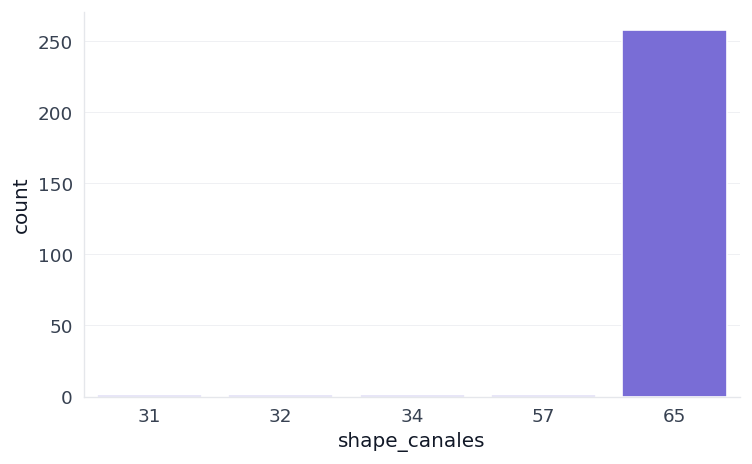

In [ ]:
# visualizacion
import seaborn as sns

sns.countplot(
    data=dwi,
    x="shape_canales"
)

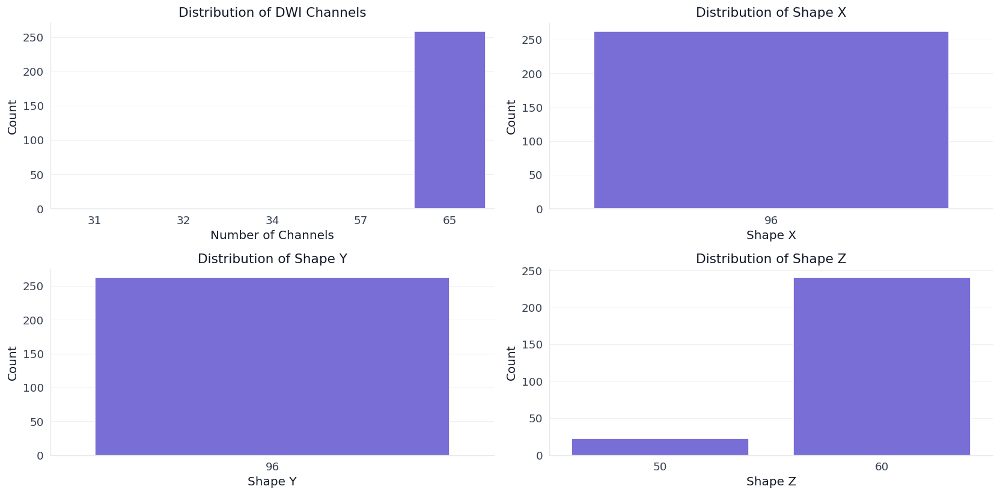

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

fig,axes = plt.subplots(2,2,figsize=(14,7))
sns.countplot(data=dwi, x="shape_canales", ax=axes[0,0])
axes[0,0].set_title('Distribution of DWI Channels')
axes[0,0].set_xlabel('Number of Channels')
axes[0,0].set_ylabel('Count')

sns.countplot(data=dwi, x="shape_x", ax=axes[0,1])
axes[0,1].set_title('Distribution of Shape X')
axes[0,1].set_xlabel('Shape X')
axes[0,1].set_ylabel('Count')

sns.countplot(data=dwi, x="shape_y", ax=axes[1,0])
axes[1,0].set_title('Distribution of Shape Y')
axes[1,0].set_xlabel('Shape Y')
axes[1,0].set_ylabel('Count')

sns.countplot(data=dwi, x="shape_z", ax=axes[1,1])
axes[1,1].set_title('Distribution of Shape Z')
axes[1,1].set_xlabel('Shape Z')
axes[1,1].set_ylabel('Count')

plt.tight_layout()
plt.show()

In [ ]:
# eliminar aquellas que no tengan los 65 canales
dwi_cleaned_chanels = dwi[dwi['shape_canales'] == 65]
new_samples = dwi_cleaned_chanels.shape[0]
print(f"Se eliminaron {dataset_diagnosis.shape[0] - new_samples} muestras")

Se eliminaron 4 muestras


In [ ]:
# visualizar una con menor niveles en z
dwi_diferente_z_shape = dwi_cleaned_chanels[dwi_cleaned_chanels['shape_z'] == 50]
dwi_diferente_z_shape.head()

,path_dwi_file,shape_x,shape_y,shape_z,shape_canales,id,diagnosis
0,/content/drive/MyDrive/root/UNAM/semestre9/min...,96,96,50,65,sub-10159,CONTROL
1,/content/drive/MyDrive/root/UNAM/semestre9/min...,96,96,50,65,sub-10171,CONTROL
2,/content/drive/MyDrive/root/UNAM/semestre9/min...,96,96,50,65,sub-10189,CONTROL
3,/content/drive/MyDrive/root/UNAM/semestre9/min...,96,96,50,65,sub-10193,CONTROL
4,/content/drive/MyDrive/root/UNAM/semestre9/min...,96,96,50,65,sub-10206,CONTROL


In [ ]:
sample_path = dwi_diferente_z_shape.iloc[0]['path_dwi_file']
visualize_dwi(
    sample_path, mode="3d", engine="volume",
    volume=0,
    percentile=(0.5,99.5), max_voxels_3d=2_500_000,
    min_stride=(1,1,1), gauss_sigma=0.3,
    title="Volumétrico"
)

Lo podemos observar es el primer volumen de un paciente dado, este volumen no cuenta con ningun tipo de difusion

In [ ]:
from math import ceil
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

def image_to_media_per_level(path_file):
    dwi = load_dwi(path_file, mode='float32') # Load data as numpy array
    data = dwi.data
    idx = np.arange(data.shape[2])
    x_mean = np.zeros(data.shape[2])
    volume_without_diffusion = dwi.data[:,:,:,0]
    for id in idx:
        x_mean[id] = np.mean(volume_without_diffusion[:,:,id])
    return idx,x_mean

def plot_leves_dwi(path_file,volume=0,levels = None):
    dwi = load_dwi(path_file, mode='float32') # Load data as numpy array
    data = dwi.data

    if levels is None:
        levels = np.arange(data.shape[2])
    else:
        levels = np.asarray(levels) # Ensure levels is a numpy array for indexing

    # Select the specified levels and volume
    v = data[:,:,levels,volume]

    ncols = 4
    nrows = ceil(v.shape[2]/ncols)

    fig,axes = plt.subplots(nrows,ncols,figsize=(3*ncols,4*nrows))
    axes = axes.flatten()

    for i in range(v.shape[2]):
        ax = axes[i]
        ax.set_title(f"Level {levels[i]}") # Use the actual level number for title
        ax.imshow(v[:,:,i],cmap='gray')
        ax.axis('off')

    # Turn off any unused subplots
    for j in range(v.shape[2], len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10159/dwi/sub-10159_dwi.nii.gz


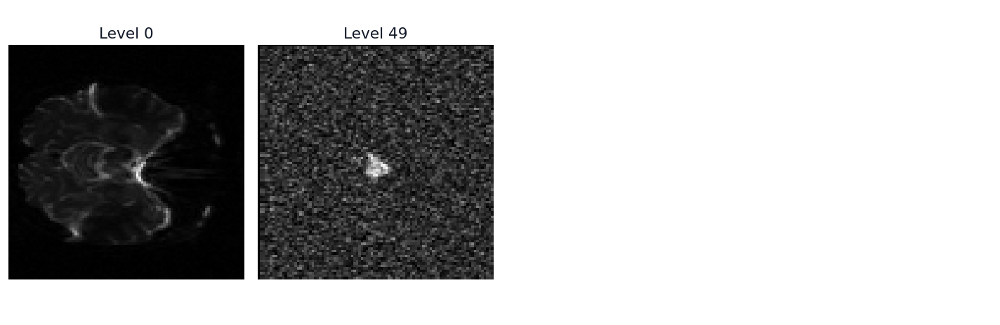

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10171/dwi/sub-10171_dwi.nii.gz


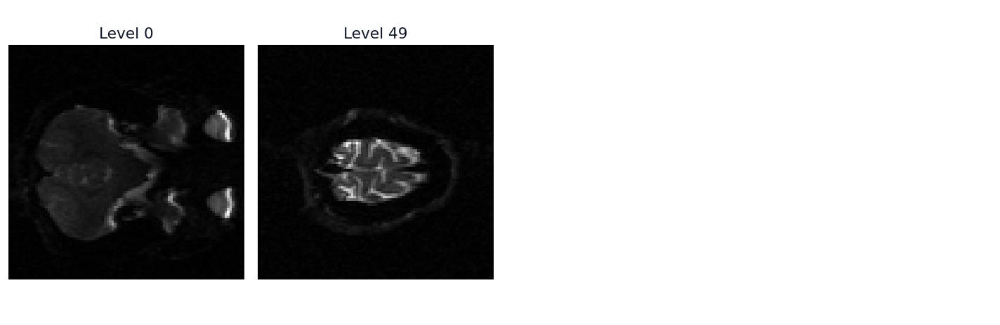

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10189/dwi/sub-10189_dwi.nii.gz


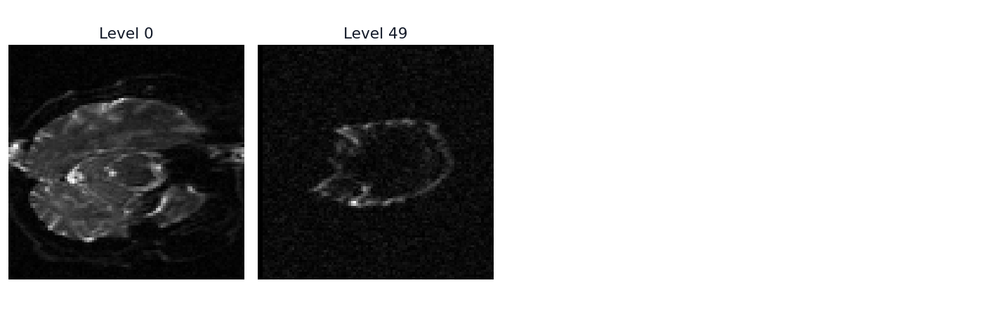

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10193/dwi/sub-10193_dwi.nii.gz


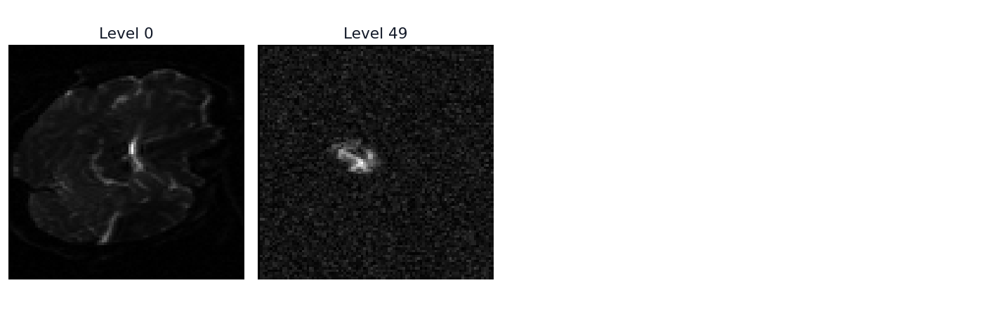

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10206/dwi/sub-10206_dwi.nii.gz


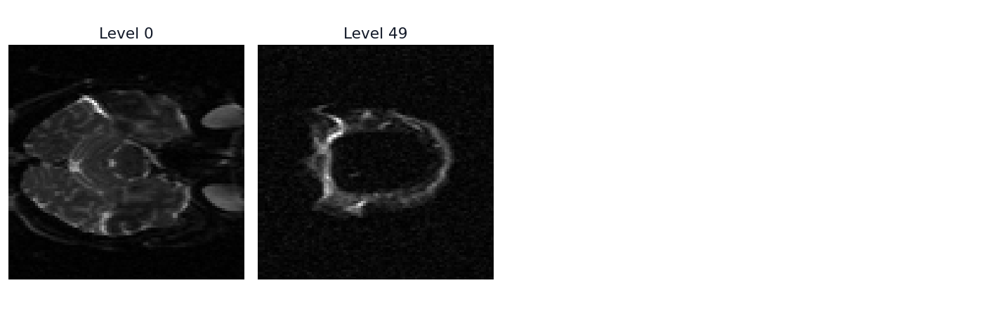

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10217/dwi/sub-10217_dwi.nii.gz


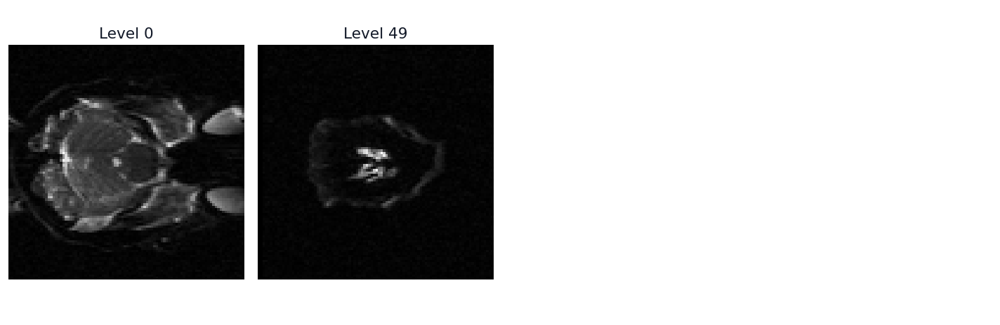

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10225/dwi/sub-10225_dwi.nii.gz


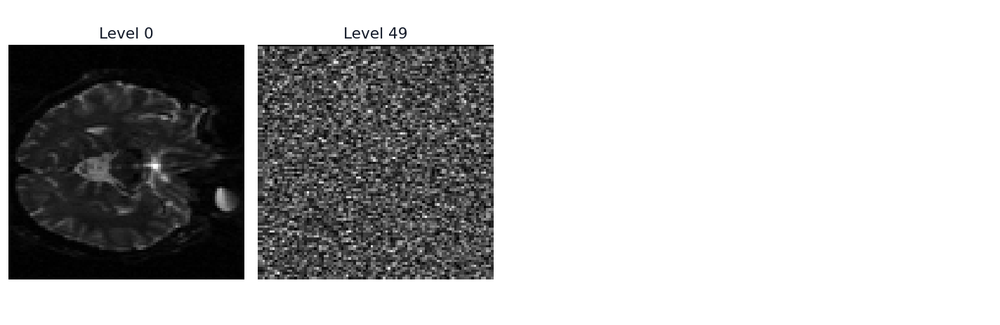

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10227/dwi/sub-10227_dwi.nii.gz


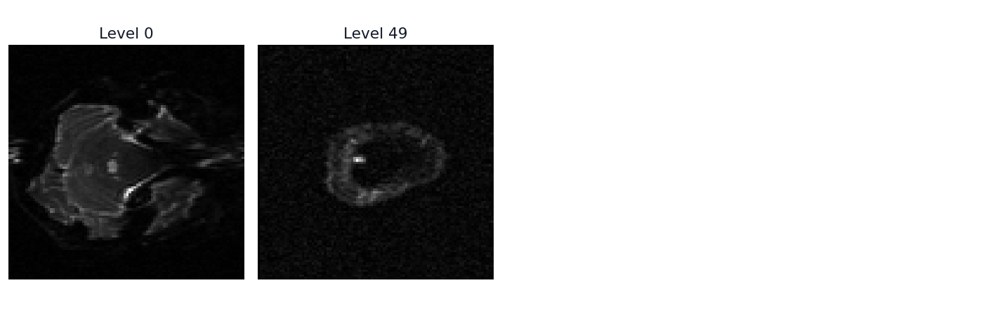

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10228/dwi/sub-10228_dwi.nii.gz


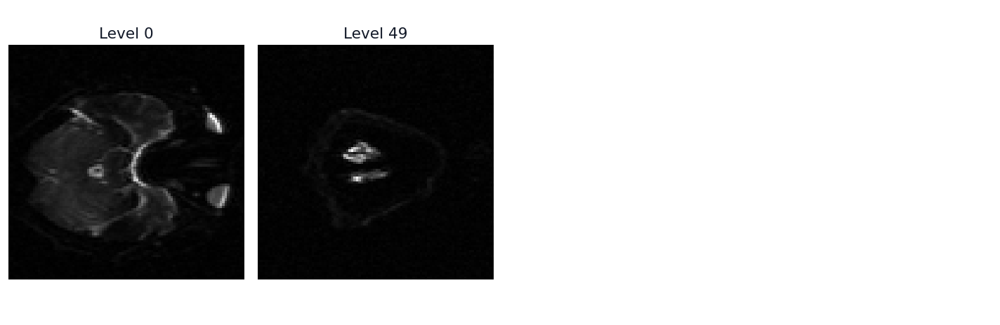

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10235/dwi/sub-10235_dwi.nii.gz


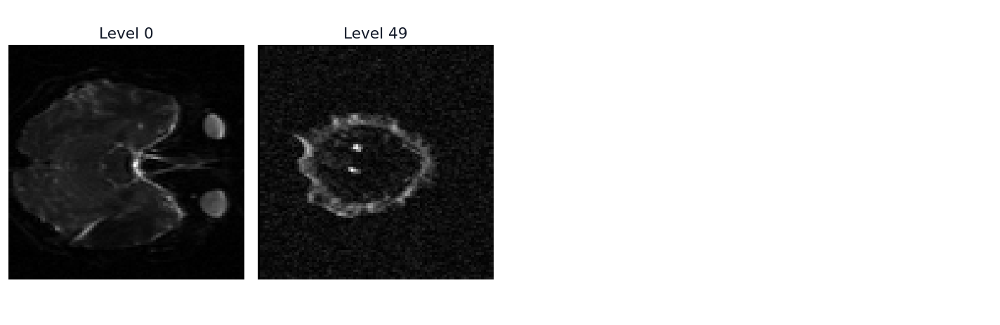

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10269/dwi/sub-10269_dwi.nii.gz


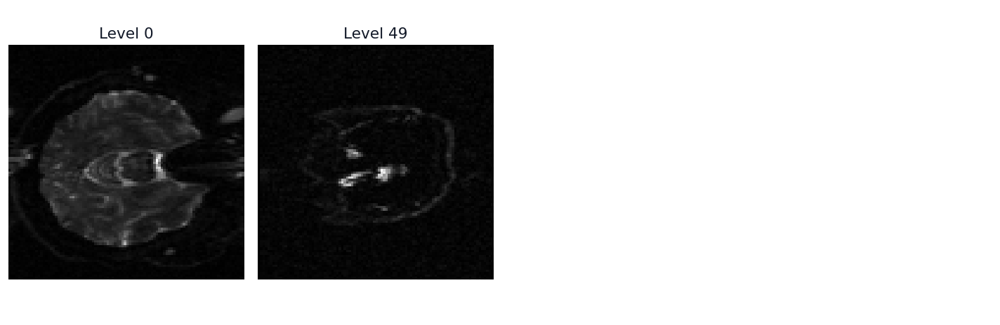

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10271/dwi/sub-10271_dwi.nii.gz


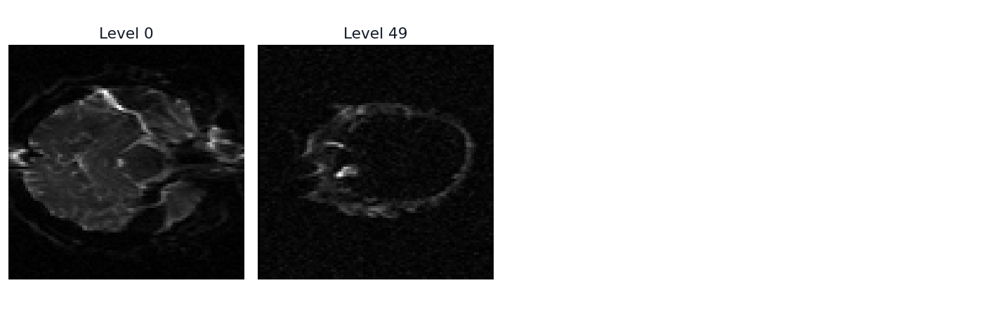

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10273/dwi/sub-10273_dwi.nii.gz


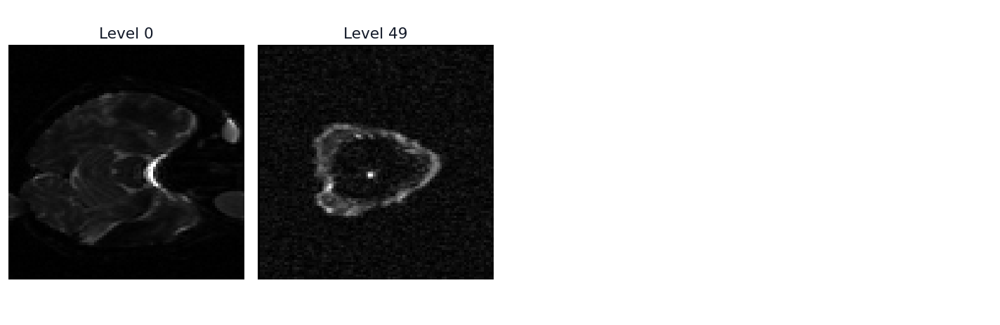

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10274/dwi/sub-10274_dwi.nii.gz


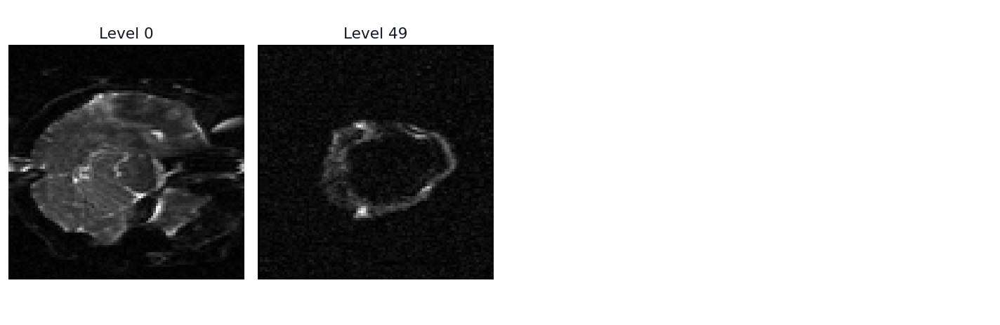

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10280/dwi/sub-10280_dwi.nii.gz


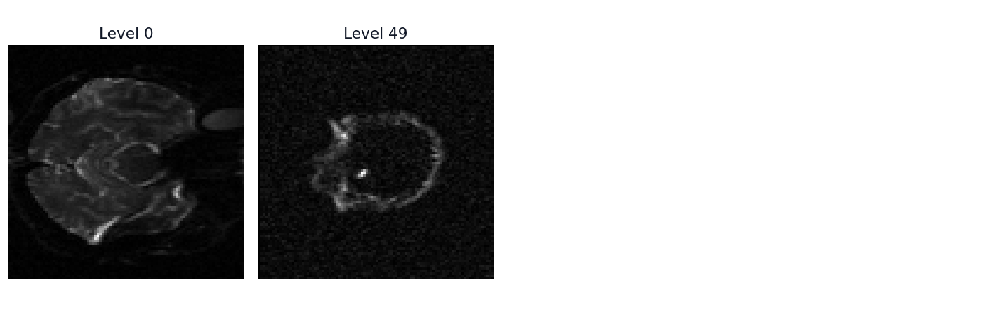

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10290/dwi/sub-10290_dwi.nii.gz


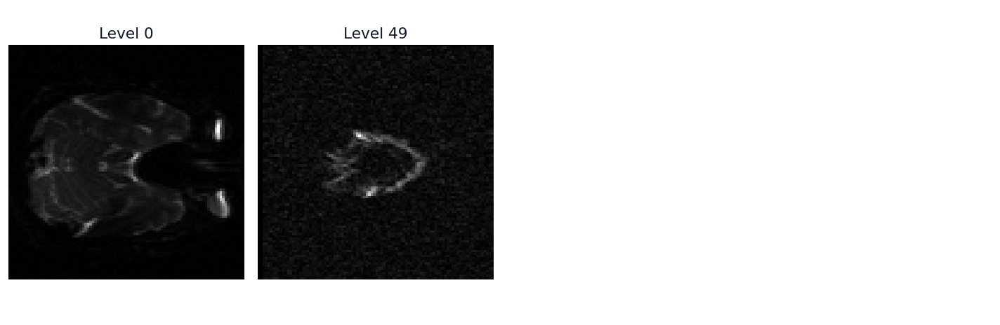

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10292/dwi/sub-10292_dwi.nii.gz


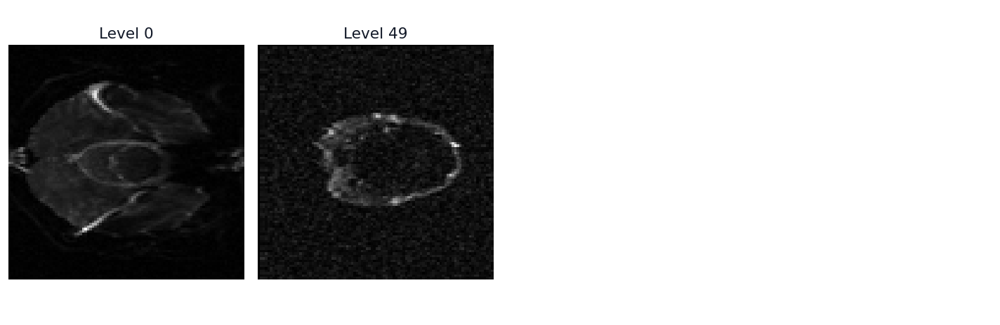

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10304/dwi/sub-10304_dwi.nii.gz


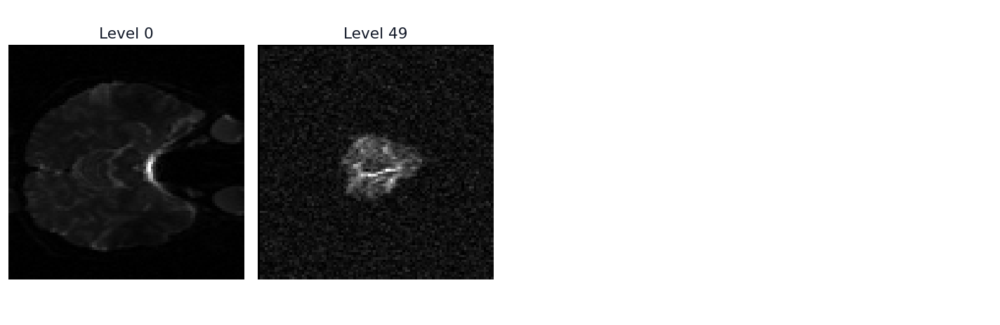

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-10316/dwi/sub-10316_dwi.nii.gz


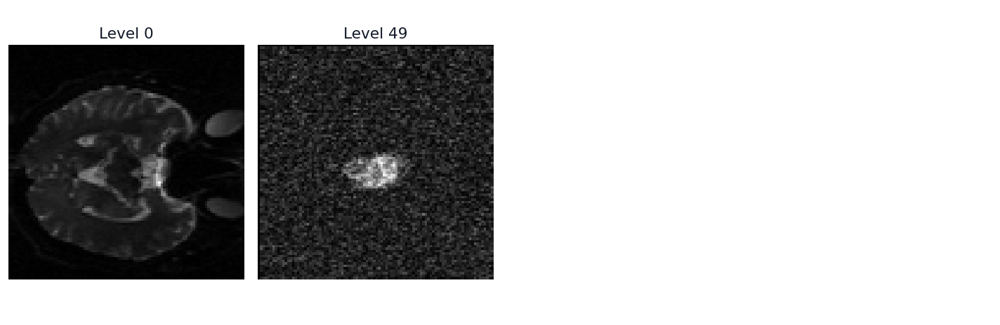

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-50005/dwi/sub-50005_dwi.nii.gz


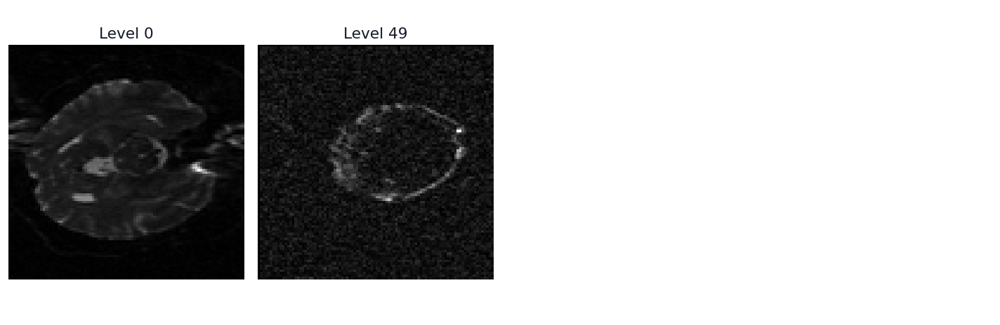

path:/content/drive/MyDrive/root/UNAM/semestre9/mineria-masiva/sub-60001/dwi/sub-60001_dwi.nii.gz


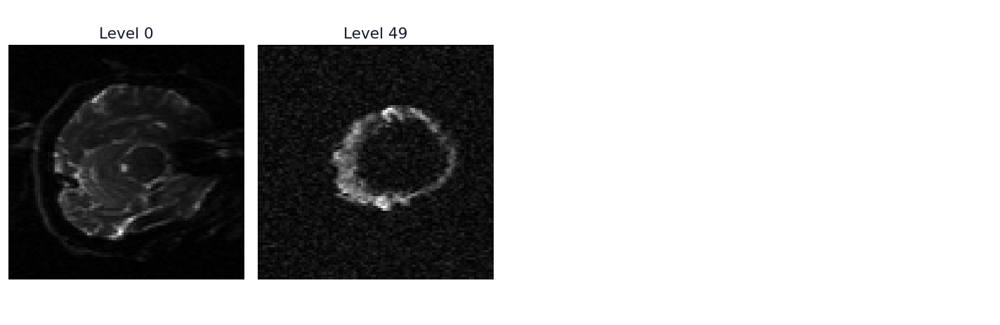

In [ ]:
for path in dwi_diferente_z_shape['path_dwi_file']:
    print(f"path:{path}")
    plot_leves_dwi(path,levels=[0,49])

En base a las imagenes, parece ser que los volumenes que tienen 50 niveles o slices en z comienzan en la parte de los ojos hacia la parte superior del craneo

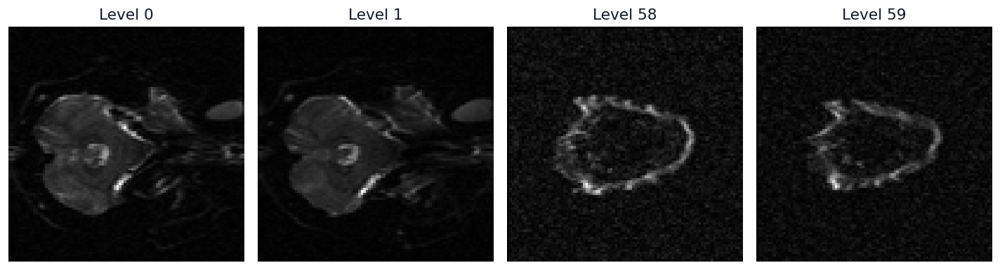

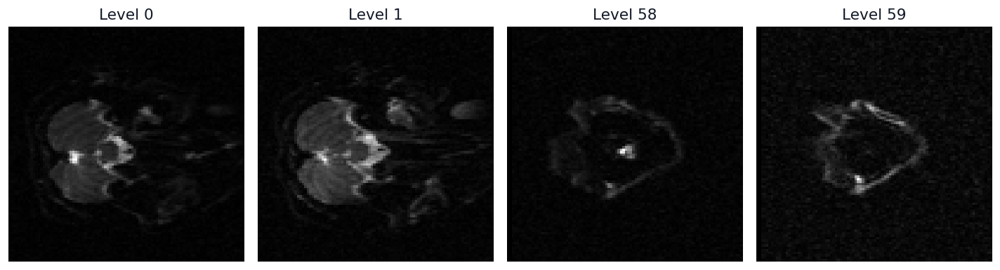

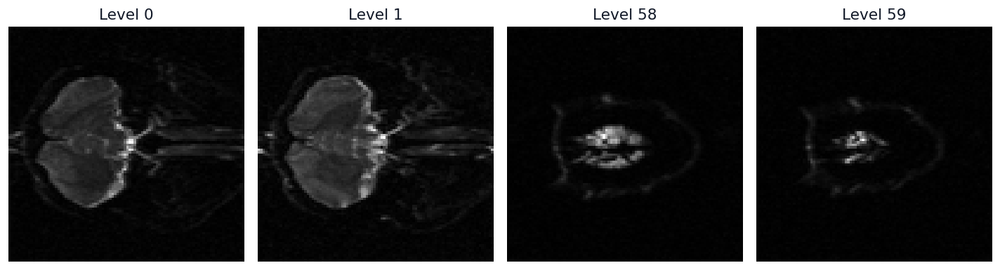

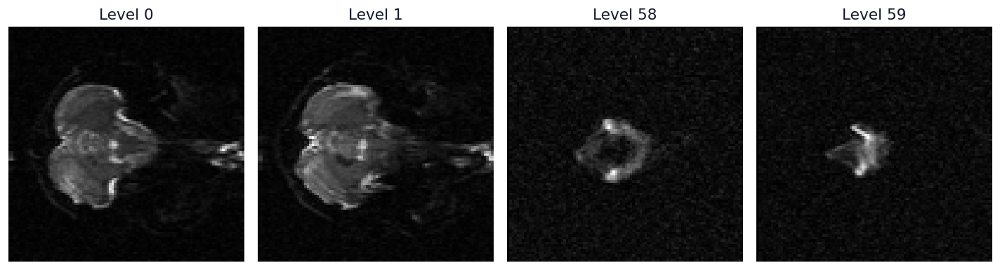

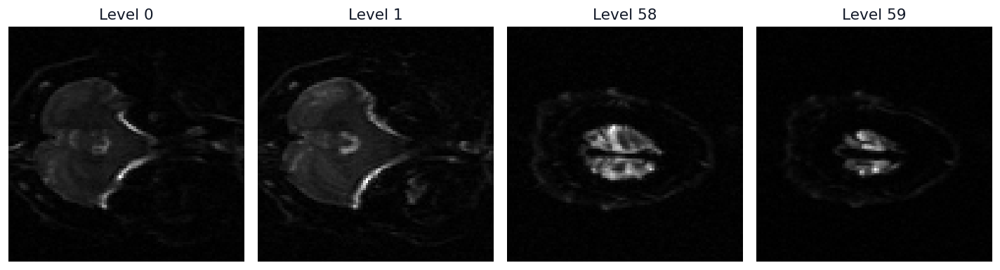

In [ ]:
dwi_with_60_levels = dwi_cleaned_chanels[dwi_cleaned_chanels['shape_z'] == 60]
for path in dwi_with_60_levels.head(5)['path_dwi_file']:
    plot_leves_dwi(path,levels=[0,1,58,59])

Luego, dentro del dataset hay volumenes que tienen unicamente 60 slices en z pero en base a las imagenes podemos observar que contemplan mas infomacion a nivel de nariz. Con ello consideramos estandarizar todo a 50 slices recortando las primeras capas a los de mayol cantidad de slices.

In [ ]:
n = dwi_with_60_levels.shape[0]
print(f"Hay {n} imagenes validas")

Hay 237 imagenes validas


vamos a trabajar de momento con solo las imagenes de 60 niveles

In [ ]:
dwi = load_dwi(dwi_with_60_levels.iloc[0]['path_dwi_file'], mode='float32')
print(dwi.data.shape)

(96, 96, 60, 65)


In [ ]:
def preparar_dwi_variantes(volumen: np.ndarray,
                           normalizar: bool = True,
                           eps: float = 1e-6,
                           dtype=np.float32):
    """
    Parámetros
    ----------
    volumen : np.ndarray
        Arreglo 4D con forma (X, Y, Z, C). Para tu caso: (96, 96, 60, 65).
        C=65 asume: canal 0 = b0, canales 1..64 = difusión.
    normalizar : bool
        Si True, aplica z-score por canal en ejes (D, H, W).
    eps : float
        Épsilon numérico para evitar división entre cero en la normalización.
    dtype : np.dtype
        Tipo de dato de salida (por defecto float32).

    Returns
    -------
    X_2  : np.ndarray
        Volumen (D, H, W, 2) con [b0, mean(diffusión)].
    X_33 : np.ndarray
        Volumen (D, H, W, 33) con [b0, impares de 1..64] (si C>=65).
        Si C<65, toma los impares disponibles hasta C-1.

    Notas
    -----
    - Reordena de (X, Y, Z, C) a (D, H, W, C) = (Z, Y, X, C), que es channels_last para Keras 3D.
    - La normalización es z-score por canal: (x - μ_c) / (σ_c + eps), con μ/σ sobre ejes espaciales (0,1,2).
    """
    if volumen.ndim != 4:
        raise ValueError(f"Se esperaba un array 4D (X,Y,Z,C); recibido {volumen.shape}")

    # Reordenar a (D, H, W, C) = (Z, Y, X, C)
    X_full = np.transpose(volumen, (2, 1, 0, 3)).astype(np.float32, copy=False)  # (D,H,W,C)
    D, H, W, C = X_full.shape
    if C < 2:
        raise ValueError("Se requieren al menos 2 canales (b0 + difusión).")

    # --- Variante X_2: b0 + promedio de difusión ---
    b0 = X_full[..., 0:1]          # (D,H,W,1)
    dm = X_full[..., 1:]           # (D,H,W,C-1)
    dm_mean = dm.mean(axis=-1, keepdims=True)  # (D,H,W,1)
    X_2 = np.concatenate([b0, dm_mean], axis=-1)  # (D,H,W,2)

    # --- Variante X_33: b0 + impares 1..64 ---
    # Si C>=65 → impares hasta 63 → 32 canales + b0 = 33
    top = min(C, 65)  # respeta límite 65 si hay más canales
    sel = np.r_[0, np.arange(1, top, 2)]  # 0,1,3,5,...,63 (según disponibilidad)
    X_33 = X_full[..., sel]  # (D,H,W, len(sel))

    # --- Normalización por canal (z-score) ---
    if normalizar:
        def zscore_channelwise(arr):
            m = arr.mean(axis=(0, 1, 2), keepdims=True)
            s = arr.std(axis=(0, 1, 2), keepdims=True)
            return (arr - m) / (s + eps)

        X_2 = zscore_channelwise(X_2)
        X_33 = zscore_channelwise(X_33)

    return X_2.astype(dtype, copy=False), X_33.astype(dtype, copy=False)

X_2,X_33 = preparar_dwi_variantes(dwi.data,normalizar=False)

In [ ]:
from __future__ import annotations
from typing import Optional, Sequence, Literal, Tuple, Union
import numpy as np

# =========================
# HELPERS (puros NumPy)
# =========================
def _finite_percentile_window(vol: np.ndarray, prc: Tuple[float, float]=(2.0, 98.0)) -> tuple[float, float]:
    m = np.isfinite(vol)
    if not m.any():
        return 0.0, 1.0
    vmin = np.percentile(vol[m], prc[0])
    vmax = np.percentile(vol[m], prc[1])
    if not np.isfinite(vmin): vmin = float(np.nanmin(vol))
    if not np.isfinite(vmax): vmax = float(np.nanmax(vol))
    if vmax <= vmin: vmax = vmin + 1e-6
    return float(vmin), float(vmax)

def _auto_bbox(vol: np.ndarray, thr: float|None=None, margin: int=2) -> tuple[slice,slice,slice]:
    v = np.nan_to_num(vol, nan=0.0, posinf=0.0, neginf=0.0)
    nz = v[v>0]
    if thr is None:
        thr = float(np.percentile(nz, 10)) if nz.size else 0.0
    mask = v > thr
    if not mask.any():
        X,Y,Z = vol.shape
        return slice(0,X), slice(0,Y), slice(0,Z)
    xs = np.where(mask.any(axis=(1,2)))[0]
    ys = np.where(mask.any(axis=(0,2)))[0]
    zs = np.where(mask.any(axis=(0,1)))[0]
    x0,x1 = max(xs[0]-margin,0), min(xs[-1]+1+margin, vol.shape[0])
    y0,y1 = max(ys[0]-margin,0), min(ys[-1]+1+margin, vol.shape[1])
    z0,z1 = max(zs[0]-margin,0), min(zs[-1]+1+margin, vol.shape[2])
    return slice(x0,x1), slice(y0,y1), slice(z0,z1)

def _strides_for_target_voxels(shape_xyz: tuple[int,int,int],
                               zooms_xyz: tuple[float,float,float]=(1.0,1.0,1.0),
                               max_voxels: int=1_200_000) -> tuple[int,int,int]:
    X,Y,Z = shape_xyz
    cur = X*Y*Z
    if cur <= max_voxels:
        return (1,1,1)
    scale = (cur / max_voxels) ** (1/3)
    dx,dy,dz = zooms_xyz
    inv = np.array([1/max(dx,1e-6), 1/max(dy,1e-6), 1/max(dz,1e-6)], dtype=float)
    inv = inv / (inv.mean() + 1e-12)
    raw = np.ceil(scale * inv).astype(int)
    sx,sy,sz = np.maximum(raw, 1)
    def voxels(s):
        return int(np.ceil(X/s[0]))*int(np.ceil(Y/s[1]))*int(np.ceil(Z/s[2]))
    # Ajuste fino hasta cumplir max_voxels
    while voxels((sx,sy,sz)) > max_voxels:
        i = int(np.argmax([X/sx, Y/sy, Z/sz]))
        if i==0: sx += 1
        elif i==1: sy += 1
        else: sz += 1
    return int(sx), int(sy), int(sz)

def _apply_stride_and_crop(vol: np.ndarray, zooms: Tuple[float,float,float],
                           max_voxels: int, crop: bool,
                           min_stride: Tuple[int,int,int]=(1,1,1)) -> tuple[np.ndarray, tuple[slice,slice,slice], tuple[int,int,int]]:
    if crop:
        sX,sY,sZ = _auto_bbox(vol)
        vol = vol[sX, sY, sZ]
    else:
        sX,sY,sZ = slice(0,vol.shape[0]), slice(0,vol.shape[1]), slice(0,vol.shape[2])
    sx,sy,sz = _strides_for_target_voxels(vol.shape[:3], zooms, max_voxels=max_voxels)
    sx,sy,sz = max(sx, min_stride[0]), max(sy, min_stride[1]), max(sz, min_stride[2])
    vol_ds = vol[::sx, ::sy, ::sz]
    return vol_ds, (sX,sY,sZ), (sx,sy,sz)

def _gaussian_if_needed(vol: np.ndarray, sigma: Optional[float]) -> np.ndarray:
    if sigma is None or sigma <= 0:
        return vol
    try:
        from scipy.ndimage import gaussian_filter
        return gaussian_filter(vol, sigma=float(sigma), mode="nearest")
    except Exception:
        return vol

def _largest_component_mask(vol: np.ndarray, thr: float, min_frac: float=0.001) -> Optional[np.ndarray]:
    try:
        from scipy import ndimage as ndi
    except Exception:
        return None
    m = vol > thr
    if not m.any():
        return None
    lbl, n = ndi.label(m)
    if n <= 1:
        return m
    sizes = ndi.sum(m, lbl, index=np.arange(1, n+1))
    biggest = int(np.argmax(sizes) + 1)
    keep = (lbl == biggest)
    total = m.size
    small = np.isin(lbl, np.where(sizes < total*min_frac)[0] + 1)
    keep[small] = False
    return keep


# =========================
# VISUALIZACIÓN SOLO NumPy
# =========================
def visualize_volume_np(
    x: np.ndarray,
    *,
    channel_axis: Optional[int] = -1,            # -1 para (X,Y,Z,C); None si es 3D puro
    volume: Union[Literal["auto","mean","median","max"], int] = "auto",
    mode: Literal["mosaic","orthogonal","interactive","3d"] = "mosaic",
    engine: Literal["auto","volume","isosurface"] = "auto",
    n_slices: int = 16,
    percentile: Tuple[float, float] = (2.0, 98.0),
    normalize: bool = False,
    figsize: Tuple[float, float] = (10, 8),
    cmap: str = "gray",
    title: Optional[str] = None,
    show: bool = True,
    # Calidad/velocidad 3D
    zooms: Tuple[float,float,float] = (1.0, 1.0, 1.0),  # espaciado voxel (dx,dy,dz)
    max_voxels_3d: int = 2_500_000,
    crop_content: bool = True,
    min_stride: Tuple[int,int,int] = (1,1,1),
    gauss_sigma: Optional[float] = 0.8,
    iso_percentile: float = 65.0,
    multi_iso: Optional[Sequence[float]] = None,  # ej (55,70)
    clean_components: bool = True,
):
    """
    Visualiza un volumen 3D o 4D **desde NumPy** (sin nibabel).

    Parámetros
    ----------
    x : np.ndarray
        3D: (X, Y, Z)
        4D: (X, Y, Z, C) por defecto (o usa `channel_axis` para indicar el eje de canal).
    channel_axis : Optional[int]
        Índice del eje de canal si `x` es 4D. Usa None si `x` ya es 3D.
    volume : {"auto","mean","median","max"} o int
        Cómo seleccionar la componente 3D si `x` es 4D. Con "auto" → índice 0.
    mode : {"mosaic","orthogonal","interactive","3d"}
        Visualización 2D (matplotlib) o 3D (plotly).
    engine : {"auto","volume","isosurface"}
        Motor 3D: 'volume' (ray casting), 'isosurface' (marching cubes si disponible).
    zooms : (dx,dy,dz)
        Espaciado de voxel para escalar ejes en 3D.

    Retorna
    -------
    fig : matplotlib.figure.Figure o plotly.graph_objects.Figure
    """
    import numpy as np

    # ---- normalizar entrada ----
    arr = np.asarray(x)
    if arr.ndim not in (3,4):
        raise ValueError(f"Se espera un array 3D o 4D; recibido shape={arr.shape}")

    # Reorganizar a 3D si es 4D
    if arr.ndim == 4:
        if channel_axis is None:
            raise ValueError("channel_axis=None pero el array es 4D; especifica el eje de canal.")
        if channel_axis != -1:
            arr = np.moveaxis(arr, channel_axis, -1)  # -> (X,Y,Z,C)
        C = arr.shape[-1]
        if isinstance(volume, int):
            if not (0 <= volume < C):
                raise IndexError(f"Índice de volumen fuera de rango 0..{C-1}")
            vol3d = arr[..., volume]
            strategy = f"idx={volume}"
        else:
            if volume == "auto":
                vol3d = arr[..., 0]; strategy = "auto:idx0"
            elif volume == "mean":
                vol3d = np.mean(arr, axis=-1); strategy = "mean(C)"
            elif volume == "median":
                vol3d = np.median(arr, axis=-1); strategy = "median(C)"
            elif volume == "max":
                vol3d = np.max(arr, axis=-1); strategy = "max(C)"
            else:
                raise ValueError(f"Estrategia desconocida: {volume}")
    else:
        vol3d = arr
        strategy = "3D"

    # ---- saneo intensidades / normalización ----
    vol = np.nan_to_num(
        vol3d, nan=0.0,
        posinf=(np.nanmax(vol3d) if np.isfinite(vol3d).any() else 0.0),
        neginf=0.0
    ).astype(np.float32, copy=False)
    if normalize:
        m, M = float(np.min(vol)), float(np.max(vol))
        if M > m: vol = (vol - m) / (M - m)

    vmin, vmax = _finite_percentile_window(vol, percentile)

    # =========================
    # 2D: matplotlib
    # =========================
    if mode == "orthogonal":
        import matplotlib.pyplot as plt
        cx, cy, cz = (s // 2 for s in vol.shape)
        fig = plt.figure(figsize=figsize)

        ax1 = fig.add_subplot(1, 3, 1)
        ax1.imshow(vol[:, :, cz].T, origin="lower", cmap=cmap, vmin=vmin, vmax=vmax)
        ax1.set_title("Axial"); ax1.axis("off")

        ax2 = fig.add_subplot(1, 3, 2)
        ax2.imshow(np.flipud(vol[:, cy, :].T), cmap=cmap, vmin=vmin, vmax=vmax)
        ax2.set_title("Coronal"); ax2.axis("off")

        ax3 = fig.add_subplot(1, 3, 3)
        ax3.imshow(np.flipud(vol[cx, :, :].T), cmap=cmap, vmin=vmin, vmax=vmax)
        ax3.set_title("Sagital"); ax3.axis("off")

        fig.suptitle(title or f"Volumen — {strategy}", y=0.98)
        fig.tight_layout()
        if show: plt.show()
        return fig

    if mode == "mosaic":
        import matplotlib.pyplot as plt
        zdim = vol.shape[2]
        n = max(1, int(n_slices))
        idxs = np.linspace(0, zdim - 1, n, dtype=int)
        ncols = int(np.ceil(np.sqrt(n)))
        nrows = int(np.ceil(n / ncols))
        fig, axes = plt.subplots(nrows, ncols, figsize=figsize)
        axes = np.atleast_1d(axes).ravel()
        for ax, zi in zip(axes, idxs):
            ax.imshow(vol[:, :, zi].T, origin="lower", cmap=cmap, vmin=vmin, vmax=vmax)
            ax.set_title(f"z={zi}"); ax.axis("off")
        for ax in axes[len(idxs):]:
            ax.axis("off")
        fig.suptitle(title or f"Volumen — {strategy} | {n} cortes", y=0.98)
        fig.tight_layout()
        if show: plt.show()
        return fig

    # =========================
    # 3D: plotly
    # =========================
    if mode in {"3d", "interactive"}:
        try:
            import plotly.graph_objects as go
        except ImportError:
            raise ImportError("El modo 3D requiere plotly (instala: pip install plotly)")

        # pre-proceso (suavizado opcional)
        vol_pre = _gaussian_if_needed(vol, sigma=gauss_sigma)
        # crop + downsample
        vol_ds, (sX,sY,sZ), (sx,sy,sz) = _apply_stride_and_crop(
            vol_pre, zooms=zooms, max_voxels=max_voxels_3d, crop=crop_content, min_stride=min_stride
        )
        dx,dy,dz = zooms
        dx_eff, dy_eff, dz_eff = dx*sx, dy*sy, dz*sz

        # motor por defecto
        if engine == "auto":
            engine = "isosurface" if vol_ds.size > 1_000_000 else "volume"

        vmin_ds, vmax_ds = _finite_percentile_window(vol_ds, percentile)
        base_iso = float(vmin_ds + (vmax_ds - vmin_ds) * (iso_percentile/100.0))
        if not np.isfinite(base_iso):
            base_iso = float(np.nanmean(vol_ds))

        mask_clean = None
        if engine == "isosurface" and clean_components:
            thr0 = float(vmin_ds + 0.5*(vmax_ds - vmin_ds))
            mask_clean = _largest_component_mask(vol_ds, thr=thr0, min_frac=0.0008)
            if mask_clean is not None:
                vol_ds = vol_ds * mask_clean.astype(vol_ds.dtype)

        isos = [base_iso]
        if multi_iso is not None and len(multi_iso) >= 2:
            isos = [float(vmin_ds + (vmax_ds - vmin_ds)*(p/100.0)) for p in multi_iso]

        # Si hay scikit-image, usar marching_cubes; si no, caer a ray casting
        if engine == "isosurface":
            try:
                from skimage.measure import marching_cubes
                use_mc = True
            except ImportError:
                use_mc = False
                engine = "volume"

        if engine == "isosurface":
            meshes = []
            for lvl in isos:
                # marching_cubes espera (Z,Y,X) → transponemos
                verts, faces, _, _ = marching_cubes(vol_ds.transpose(2,1,0), level=lvl, step_size=1)
                vx = verts[:,2]*dx_eff; vy = verts[:,1]*dy_eff; vz = verts[:,0]*dz_eff
                i,j,k = faces.T
                meshes.append(go.Mesh3d(
                    x=vx, y=vy, z=vz, i=i, j=j, k=k,
                    opacity=0.82, flatshading=False,
                    lighting=dict(ambient=0.3, diffuse=0.7, specular=0.35, roughness=0.9)
                ))
            fig = go.Figure(data=meshes)
        else:
            # Ray casting volumétrico
            V = vol_ds.transpose(2,1,0).ravel(order="C")
            nz, ny, nx = vol_ds.shape[2], vol_ds.shape[1], vol_ds.shape[0]
            z = np.arange(nz, dtype=np.float32) * dz_eff
            y = np.arange(ny, dtype=np.float32) * dy_eff
            x = np.arange(nx, dtype=np.float32) * dx_eff
            Z = np.repeat(z, ny*nx); Y = np.tile(np.repeat(y, nx), nz); X = np.tile(x, ny*nz)
            fig = go.Figure(data=go.Volume(
                x=X, y=Y, z=Z, value=V,
                isomin=float(vmin_ds), isomax=float(vmax_ds),
                surface_count=16, opacity=0.22,
                caps=dict(x_show=False,y_show=False,z_show=False),
                colorscale="Gray", showscale=False
            ))

        fig.update_layout(
            width=int(figsize[0]*96), height=int(figsize[1]*96),
            title=title or f"Volumen 3D — {strategy}  |  crop:{crop_content} stride:{(sx,sy,sz)}",
            margin=dict(l=0,r=0,t=40,b=0),
            scene=dict(
                xaxis_title="i · dx", yaxis_title="j · dy", zaxis_title="k · dz",
                aspectmode="data"
            ),
        )
        return fig

    raise ValueError(f"Modo desconocido: {mode}")


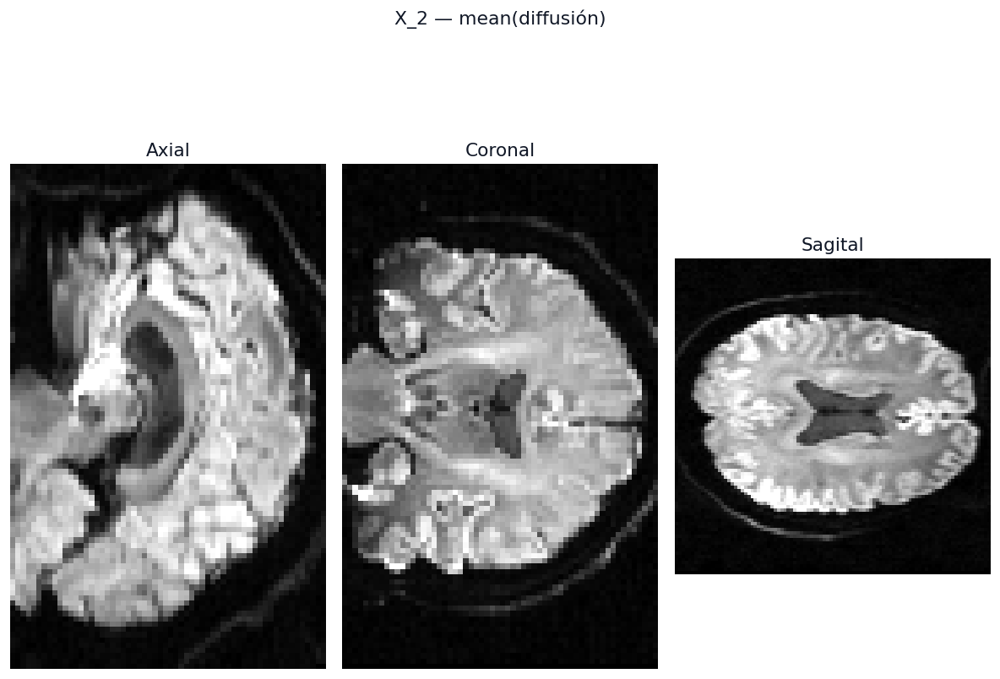

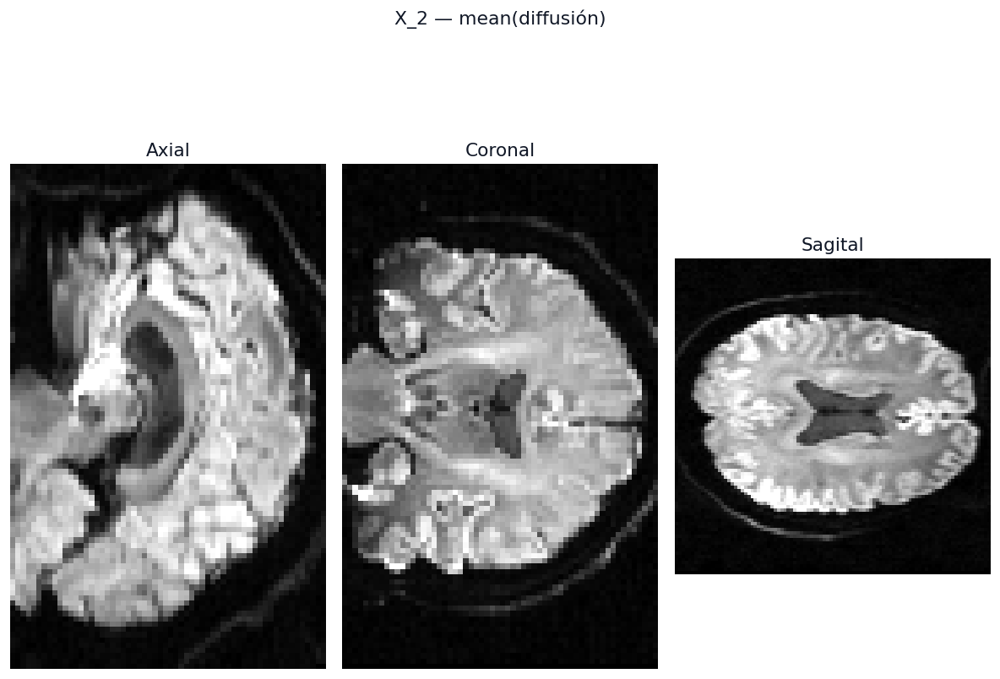

In [ ]:
visualize_volume_np(
    X_2,                # shape (D, H, W, 2)
    channel_axis=-1,    # canales al final
    volume=1,           # 1 = promedio de difusión
    mode="orthogonal",  # o "mosaic", "3d"
    title="X_2 — mean(diffusión)"
)